<a href="https://colab.research.google.com/github/kartik-kumarr/HumanPose/blob/main/mmWaveRADAR.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## SEGMENTATION MASK PREDICTION(MMWAVE RADAR HORIZONTAL AND VERTICAL HEATMAPS)

In [ ]:
!wget -O dataset.zip 'https://zenodo.org/record/12611978/files/P1.zip?download=1'

--2025-03-25 04:00:21--  https://zenodo.org/record/12611978/files/P1.zip?download=1
Resolving zenodo.org (zenodo.org)... 188.185.43.25, 188.185.45.92, 188.185.48.194, ...
Connecting to zenodo.org (zenodo.org)|188.185.43.25|:443... connected.
HTTP request sent, awaiting response... 301 MOVED PERMANENTLY
Location: /records/12611978/files/P1.zip [following]
--2025-03-25 04:00:22--  https://zenodo.org/records/12611978/files/P1.zip
Reusing existing connection to zenodo.org:443.
HTTP request sent, awaiting response... 200 OK
Length: 24808906821 (23G) [application/octet-stream]
Saving to: ‘dataset.zip’

dataset.zip         100%[===================>]  23.10G  15.0MB/s    in 29m 45s 

2025-03-25 04:30:07 (13.3 MB/s) - ‘dataset.zip’ saved [24808906821/24808906821]



In [ ]:
## Verifying if the dataset is being downloaded
!ls -lh /content/

total 24G
-rw-r--r-- 1 root root  24G Mar 25 04:30 dataset.zip
drwxr-xr-x 1 root root 4.0K Mar 21 13:33 sample_data


In [ ]:
!unzip /content/dataset.zip -d /content/dataset/

Streaming output truncated to the last 5000 lines.
  inflating: /content/dataset/d4s1/003/00775_radar.npz  
  inflating: /content/dataset/d4s1/003/00712_bbox.npz  
  inflating: /content/dataset/d4s1/003/00465_bbox.npz  
  inflating: /content/dataset/d4s1/003/00644_radar.npz  
  inflating: /content/dataset/d4s1/003/00145_radar.npz  
  inflating: /content/dataset/d4s1/003/00061_bbox.npz  
  inflating: /content/dataset/d4s1/003/00687_radar.npz  
  inflating: /content/dataset/d4s1/003/00396_bbox.npz  
  inflating: /content/dataset/d4s1/003/00241_pose.npz  
  inflating: /content/dataset/d4s1/003/00743_mask.npz  
  inflating: /content/dataset/d4s1/003/00508_radar.npz  
  inflating: /content/dataset/d4s1/003/00836_radar.npz  
  inflating: /content/dataset/d4s1/003/00098_bbox.npz  
  inflating: /content/dataset/d4s1/003/00090_pose.npz  
  inflating: /content/dataset/d4s1/003/00729_pose.npz  
  inflating: /content/dataset/d4s1/003/00033_pose.npz  
  inflating: /content/dataset/d4s1/003/00196_ma

# 1 Loading required libraries

In [ ]:
import numpy as np
import os
import pandas as pd
import cv2

# 2 Loading Dataset

In [ ]:
# root = sessionID+'/alignment/'
# root = '/data/datasets/mmvr_release_candidate_v6_downsampling/d9s3/007/'
# root = os.path.expanduser('~/Downloads/Datasets/P1/d1s1/000/')
# index = root + '00060'


root = os.path.expanduser('/content/dataset/')
dirNames = []



# Traverse the directory
for dirpath, dirnames, filenames in os.walk(root):
    dirNames = dirnames
    break
    # for filename in filenames:
    #     full_path = os.path.join(dirpath, filename)
    #     print(dirpath)
    #     all_files.append(full_path)

dirNames.remove('figs')
dirNames.remove('d3s1')
dirNames.remove('d4s1')
dirNames.remove('d1s1')
dirNames.remove('d3s2')
dirNames.remove('d2s2')
#dirNames.remove('d1s2')
print(dirNames)

['d1s2']


2.1 Connected joints in Keypoints

In [ ]:
# for plot
import matplotlib.pyplot as plt
import matplotlib.patches as patches
# joints connections for 2d keypoints
connections = np.array([[13, 15], [11, 13], [14, 16], [12, 14], [11, 12],
                [5, 11], [6, 12], [5, 6], [5, 7], [6, 8], [7, 9],
                [8, 10], [1, 2], [0, 1], [0, 2], [1, 3], [2, 4],
                [3, 5], [4, 6]])

2.2 Loading Dataset into DataFrame

In [ ]:
import numpy as np
import pandas as pd

def getDATA(index):
    ## Loading meta data
    with np.load(index + '_meta.npz', mmap_mode='r') as meta_data:
        pass

    ## Loading radar data from npz files
    with np.load(index + '_radar.npz', mmap_mode='r') as radar_data:
        hori = radar_data['hm_hori']  # (256, 128)
        vert = radar_data['hm_vert']  # (256, 128)

    ## Loading bounding box data from npz files
    with np.load(index + '_bbox.npz', mmap_mode='r') as bbox_data:
        bbox_i = bbox_data['bbox_i']
        bbox_hori = bbox_data['bbox_hori']
        bbox_vert = bbox_data['bbox_vert']

    ## Loading pose data from npz files  from npz files
    with np.load(index + '_pose.npz', mmap_mode='r') as pose_data:
        kp = pose_data['kp']  # (n, 17, 3)

    ## Loading segmentation mask data from npz files
    with np.load(index + '_mask.npz', mmap_mode='r') as mask_data:
        mask = mask_data['mask']

    return hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask


2.3 Loading the P1 folders data only(Traning as well as testing)

In [ ]:
import os
import pandas as pd

def process_folder(root, folderName):
    folder_path = os.path.join(root, folderName)
    print(folder_path)

    # Get the immediate subdirectories (timeSteps)
    currDirNames = next(os.walk(folder_path))[1]  # Faster than looping

    # Process each timeStep
    for timeStep in currDirNames:
        filePath = os.path.join(folder_path, timeStep)
        print("#################################")
        print(f"Processing timeStep: {timeStep}")

        # Initialize list to store row data
        data_rows = []

        # Get file count in timeStep directory
        lengthFiles = len(next(os.walk(filePath))[2])  # Avoid extra loops

        # Process files in chunks
        startDir = "00000"
        for index in range((lengthFiles // 5) - 1):
            index_path = os.path.join(filePath, startDir)
            hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = getDATA(index_path)

            # Append the extracted data to the list
            data_rows.append({
                'timeStep': f"{timeStep}_{startDir}",
                'hori': hori,
                'vert': vert,
                'bbox_hori': bbox_hori,
                'bbox_vert': bbox_vert,
                'bbox_i': bbox_i,
                'kp': kp,
                'mask': mask
            })

            ## Incrementing the timeStepDir name
            startDir = f"{int(startDir) + 1:05d}"

        ## Yield a DataFrame for each batch
        if data_rows:
            yield pd.DataFrame(data_rows)

## function to process folders and store data in DF
def main(root, dirNames):
    data_frames = []  # Store DataFrames in a list

    for folderName in dirNames:
        for temp_df in process_folder(root, folderName):
            data_frames.append(temp_df)  ## Collecting temp DFs

    ## Concatenate all DataFrames at once
    return pd.concat(data_frames, ignore_index=True) if data_frames else pd.DataFrame()

df = main(root, dirNames)

/content/dataset/d1s2
#################################
Processing timeStep: 000
#################################
Processing timeStep: 008
#################################
Processing timeStep: 017
#################################
Processing timeStep: 004
#################################
Processing timeStep: 009
#################################
Processing timeStep: 001
#################################
Processing timeStep: 013
#################################
Processing timeStep: 019
#################################
Processing timeStep: 010
#################################
Processing timeStep: 003
#################################
Processing timeStep: 007
#################################
Processing timeStep: 014
#################################
Processing timeStep: 012
#################################
Processing timeStep: 011
#################################
Processing timeStep: 005
#################################
Processing timeStep: 002
#################################


In [ ]:
print(df.shape)

(17598, 8)


In [ ]:
mid = df.shape[0]//2

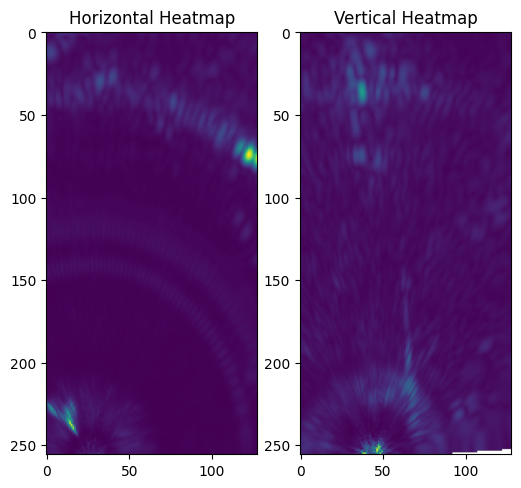

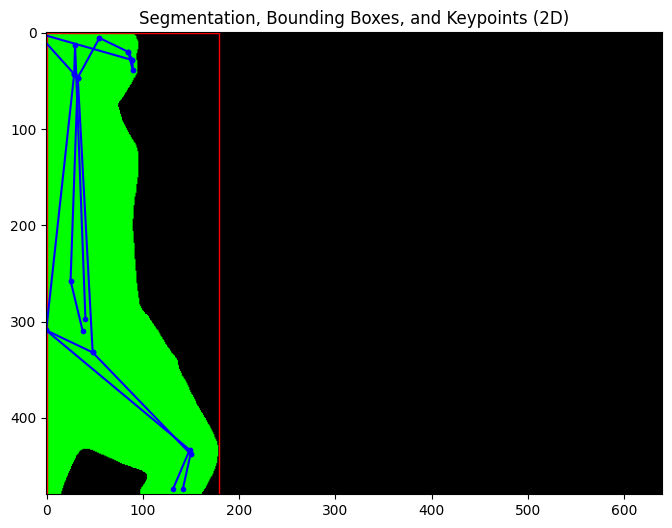

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches

def plot_heatmaps_and_annotations(hori, vert, mask, bbox_i, kp, connections):
    # Plot horizontal and vertical heatmaps side by side
    fig = plt.figure(figsize=(6, 6))

    ax = fig.add_subplot(1, 2, 1)
    ax.imshow(hori)
    ax.set_title('Horizontal Heatmap')

    ax = fig.add_subplot(1, 2, 2)
    ax.imshow(vert)
    ax.set_title('Vertical Heatmap')

    plt.show()

    # Plot segmentation, bounding boxes, and keypoints
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(1, 1, 1)

    # Create an empty image to overlay the masks
    img = np.zeros((480, 640, 3), dtype=np.uint8)

    # print(mask.shape)


    for j in range(mask.shape[0]):
        ## converting the mask data from boolean to int
        # tempMask = mask[j, :, :].astype(np.uint8)
        # ## resizing the mask to 240*320 dimensions
        # tempMask = cv2.resize(tempMask, (128, 256), interpolation = cv2.INTER_NEAREST)

        # tempMask = np.expand_dims(tempMask, axis=0)

        # Apply segmentation mask (green)
        img[mask[j, :, :]==1] = (0, 255, 0)

        # # Scaling factors
        # scaleX = 128 / mask.shape[2]
        # scaleY = 256 / mask.shape[1]


        # Draw bounding boxes (red)
        x1, y1, x2, y2 = bbox_i[j, :4]
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((int(x1), int(y1)), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        # Plot keypoints (blue)
        for connection in connections:
            x = kp[j, connection, 0]
            y = kp[j, connection, 1]
            ax.plot(x, y, color='b', marker='.')

    ax.imshow(img)
    ax.set_title('Segmentation, Bounding Boxes, and Keypoints (2D)')
    plt.show()

##
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[0, :]
plot_heatmaps_and_annotations(hori, vert, mask, bbox_i, kp, connections)

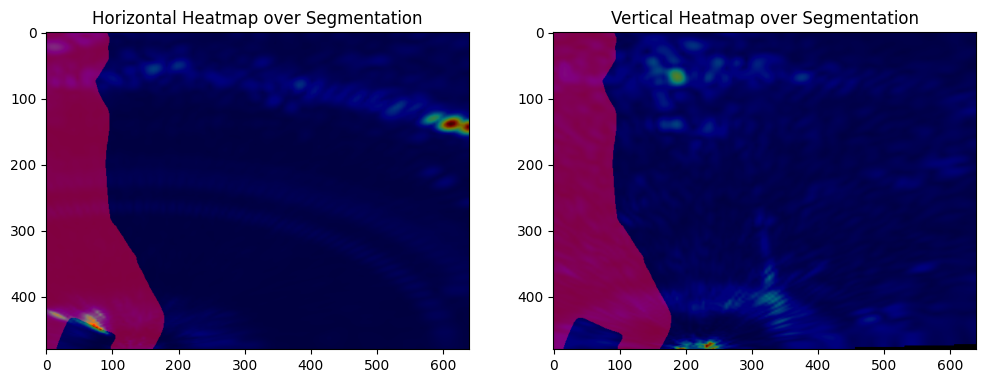

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2  # For resizing

def plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))
    scale_x = 640 / 128  # Width scale
    scale_y = 480 / 256  # Height scale
    hori_resized = cv2.resize(hori, (640, 480), interpolation=cv2.INTER_LINEAR)
    vert_resized = cv2.resize(vert, (640, 480), interpolation=cv2.INTER_LINEAR)

    # # Normalize heatmaps for better visualization
    # hori_resized = (hori_resized - np.min(hori_resized)) / (np.max(hori_resized) - np.min(hori_resized))
    # vert_resized = (vert_resized - np.min(vert_resized)) / (np.max(vert_resized) - np.min(vert_resized))

    # Create an RGB mask visualization
    mask_vis = np.zeros((mask.shape[1], mask.shape[2], 3), dtype=np.uint8)
    mask_vis[mask[0] == 1] = (255, 0, 0)  # Apply red for segmentation mask

    # Overlay horizontal heatmap
    axes[0].imshow(mask_vis)  # Show segmentation mask
    axes[0].imshow(hori_resized, cmap='jet', alpha=0.5)  # Overlay heatmap with transparency
    axes[0].set_title("Horizontal Heatmap over Segmentation")

    # Overlay vertical heatmap
    axes[1].imshow(mask_vis)
    axes[1].imshow(vert_resized, cmap='jet', alpha=0.5)
    axes[1].set_title("Vertical Heatmap over Segmentation")

    plt.show()

# Example usage:
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[0, :]
plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections)


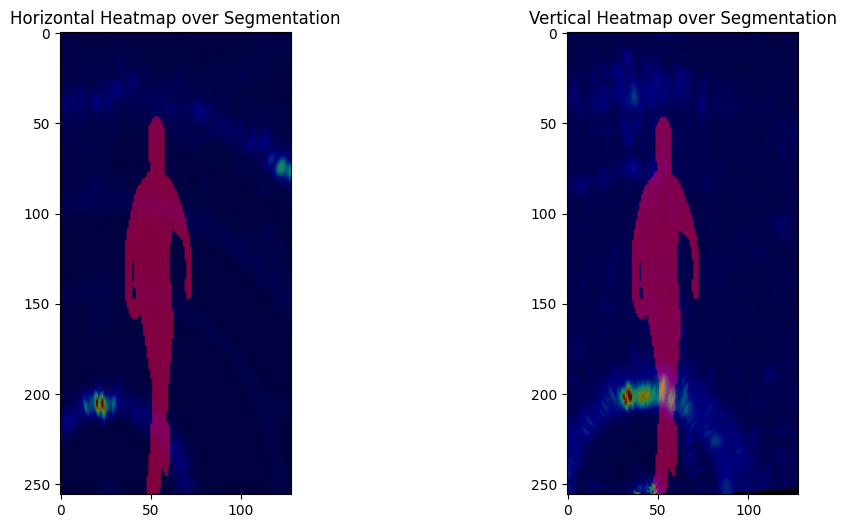

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import cv2  # For resizing

def plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections):
    fig, axes = plt.subplots(1, 2, figsize=(12, 6))

    # Resize the mask to match the heatmap dimensions (256, 128)
    mask_resized = cv2.resize(mask[0].astype(np.uint8), (128, 256), interpolation=cv2.INTER_NEAREST)

    # Create an RGB mask visualization
    mask_vis = np.zeros((256, 128, 3), dtype=np.uint8)
    mask_vis[mask_resized == 1] = (255, 0, 0)  # Apply red for segmentation mask

    # Overlay horizontal heatmap
    axes[0].imshow(mask_vis)  # Show segmentation mask
    axes[0].imshow(hori, cmap='jet', alpha=0.5)  # Overlay heatmap with transparency
    axes[0].set_title("Horizontal Heatmap over Segmentation")

    # Overlay vertical heatmap
    axes[1].imshow(mask_vis)
    axes[1].imshow(vert, cmap='jet', alpha=0.5)
    axes[1].set_title("Vertical Heatmap over Segmentation")

    plt.show()

# Example usage:
timeStep, hori, vert, bbox_hori, bbox_vert, bbox_i, kp, mask = df.iloc[10, :]
plot_heatmaps_with_mask(hori, vert, mask, bbox_i, kp, connections)

In [ ]:
# x1, y1, x2, y2 = bbox_i[0, :4]
# width = x2 - x1
# height = y2 - y1


# print(f"width:{width}, height:{height}")

In [ ]:
print(vert)

[[13629655. 13012603. 12907889. ... 12011933. 12072981. 11904004.]
 [14128980. 13373808. 13039439. ... 11745896. 11754248. 11699532.]
 [13999461. 13346597. 12911496. ... 11308437. 11376044. 11345626.]
 ...
 [43301372. 39229080. 32791914. ...       nan       nan       nan]
 [44076784. 39244876. 32409810. ...       nan       nan       nan]
 [44449384. 39241372. 32053084. ...       nan       nan       nan]]


In [ ]:
import numpy as np
import cv2
import pandas as pd
from skimage.transform import resize
import gc  # Garbage collector for memory management

# Define the functions (same as your provided code)
def checKNans(heatmap):
    y, x = np.where(np.isnan(heatmap))
    return list(zip(x, y))

def flipHeatmaps(orig, toBeFilled, Nanidx):
    toBeFilled_filled = toBeFilled.copy()
    for x, y in Nanidx:
        toBeFilled_filled[y, x] = orig[y, x]
    return toBeFilled_filled

def fillWithNeigh(heatmap):
    mask = np.isnan(heatmap).astype(np.uint8) * 255
    heatmap32 = np.nan_to_num(heatmap, nan=0).astype(np.float32)  # Use float32 to save memory
    heatmapFilled = cv2.inpaint(heatmap32, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA)
    return heatmapFilled

def flipAndFill(horizontal, vertical):
    NanMaskHori = checKNans(horizontal)
    NanMaskVert = checKNans(vertical)
    if len(NanMaskVert) > 0 and len(NanMaskHori) == 0:
        vertical = flipHeatmaps(horizontal, vertical, NanMaskVert)
        return horizontal, vertical
    elif len(NanMaskVert) == 0 and len(NanMaskHori) > 0:
        horizontal = flipHeatmaps(vertical, horizontal, NanMaskHori)
        return horizontal, vertical
    elif len(NanMaskVert) > 0 and len(NanMaskHori) > 0:
        filledHori = fillWithNeigh(horizontal)
        filledVert = fillWithNeigh(vertical)
        return filledHori, filledVert
    else:
        return horizontal, vertical

## This function normalises the heatmaps
def normalizeHeatmaps(heatmap):
    return cv2.normalize(heatmap, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

# Add new columns for filled heatmaps
df['filled_hori'] = None
df['filled_vert'] = None
df['mask_resized'] = None

# Counters for NaN values
cNanVert = 0
cNanHori = 0


halfidx = len(df) // 2
dfHalf = df.iloc[:halfidx].copy()

# Loop through each row in the DataFrame
for idx, row in df.iterrows():
    hori = row['hori']
    vert = row['vert']
    mask = row['mask']

    # Print starting pixel of NaN values in both heatmaps
    nan_hori = checKNans(hori)
    nan_vert = checKNans(vert)
    if nan_hori:
        cNanHori += 1
    if nan_vert:
        cNanVert += 1

    # Fill NaNs in the heatmaps
    filled_hori, filled_vert = flipAndFill(hori, vert)

    ## Normalizing the heatmaps
    filled_hori = normalizeHeatmaps(filled_hori)
    filled_vert = normalizeHeatmaps(filled_vert)

    # Store the filled heatmaps and resized mask in the new columns
    df.at[idx, 'filled_hori'] = filled_hori
    df.at[idx, 'filled_vert'] = filled_vert

    # Free up memory for variables no longer needed
    # del hori, vert, mask, filled_hori, filled_vert, mask_resized



In [ ]:
import time

start = time.time()

## Resize the mask to match the heatmap dimensions (256x128)
mask_resized = resize(df['mask'][0], (256, 128), order=0, preserve_range=True, anti_aliasing=False).astype(np.uint8)

end = time.time()

import resource

resource.getrusage(resource.RUSAGE_SELF).ru_maxrss

print(f"Time:{end - start}")

Time:0.27060675621032715


In [ ]:
# Display the updated DataFrame
print(df[['filled_hori', 'filled_vert', 'mask_resized']].head())

                                         filled_hori  \
0  [[0.06381309, 0.078794084, 0.078582205, 0.0717...   
1  [[0.040701378, 0.050597347, 0.050672796, 0.045...   
2  [[0.07304751, 0.09148236, 0.09138507, 0.081685...   
3  [[0.042654086, 0.054230414, 0.05614778, 0.0536...   
4  [[0.028476633, 0.0324009, 0.030877417, 0.02693...   

                                         filled_vert mask_resized  
0  [[0.040033404, 0.037250046, 0.038399607, 0.036...         None  
1  [[0.039987866, 0.03624398, 0.035491243, 0.0333...         None  
2  [[0.039382815, 0.036446474, 0.037643023, 0.036...         None  
3  [[0.027605241, 0.0253357, 0.02438747, 0.023572...         None  
4  [[0.0231797, 0.020976743, 0.019420955, 0.01799...         None  


Total nans in horizontal heatmap:0
Total nans in vertical heatmap:17598


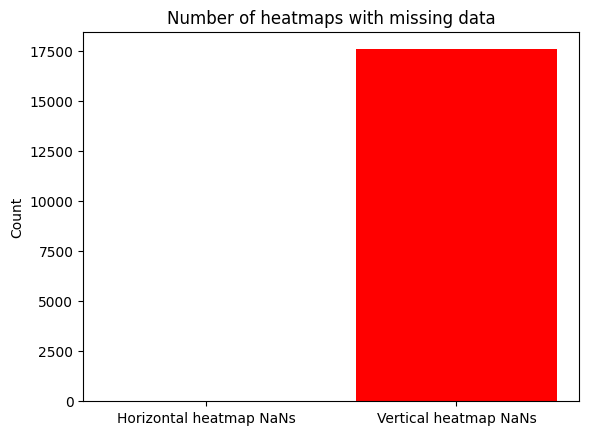

In [ ]:
print(f"Total nans in horizontal heatmap:{cNanHori}")
print(f"Total nans in vertical heatmap:{cNanVert}")


val = [cNanHori, cNanVert]
labels = ['Horizontal heatmap NaNs', 'Vertical heatmap NaNs']

plt.bar(labels, val, color = ['blue', 'red'])
plt.title("Number of heatmaps with missing data")
plt.ylabel('Count')
plt.show()

In [ ]:
rand = int(np.random.uniform(0, df.shape[1]))

print(f"Generating the mesh for instance: {rand}")


Generating the mesh for instance: 7


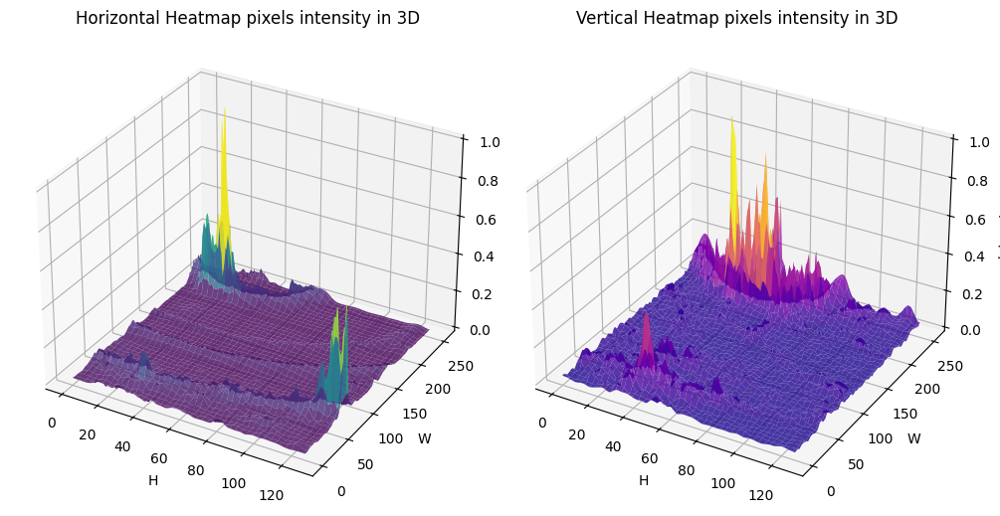

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Example heatmaps (replace with your actual data)
hori = df['filled_hori'][rand]
vert = df['filled_vert'][rand]

# Create a grid of x and y coordinates
x = np.arange(hori.shape[1])
y = np.arange(hori.shape[0])
x, y = np.meshgrid(x, y)

# Create a 3D figure
fig = plt.figure(figsize=(10, 10))

# Plot the horizontal heatmap as a 3D surface
ax1 = fig.add_subplot(121, projection='3d')  # First subplot
ax1.plot_surface(x, y, hori, cmap='viridis', alpha=0.8)
ax1.set_xlabel('H')
ax1.set_ylabel('W')
ax1.set_zlabel('Intensity')
ax1.set_title('Horizontal Heatmap pixels intensity in 3D')

# Plot the vertical heatmap as a 3D surface
ax2 = fig.add_subplot(122, projection='3d')
ax2.plot_surface(x, y, vert, cmap='plasma', alpha=0.8)
ax2.set_xlabel('H')
ax2.set_ylabel('W')
ax2.set_zlabel('Intensity')
ax2.set_title('Vertical Heatmap pixels intensity in 3D')


plt.tight_layout()
plt.show()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from scipy.stats import pearsonr
import matplotlib.patches as mpatches
from skimage.transform import resize
from google.colab import files

def visualizeHeatmaps(i, df, save_path=None):
    ## Getting first instance
    hori = df['filled_hori'][i]  # Normalized horizontal heatmap
    vert = df['filled_vert'][i]  # Normalized vertical heatmap

    ## Getting bbox coordinates
    bbox = df['bbox_i'][i]

    ## Getting the mask for the same instance
    mask = df['mask'][i]  # Assuming mask is a 2D boolean array
    mask = np.squeeze(mask)

    # Resize the mask to match the heatmap dimensions
    mask_resized = resize(mask, (256, 128), order=0, preserve_range=True, anti_aliasing=False).astype(bool)

    ## Pearson correlation between the heatmaps
    correlation, _ = pearsonr(hori.flatten(), vert.flatten())

    ## Creating a figure with a 2x2 grid layout
    fig = plt.figure(figsize=(12, 10))

    ## First subplot: Horizontal heatmap
    ax1 = fig.add_subplot(2, 2, 1)
    ax1.imshow(hori, cmap='viridis', aspect='auto')
    ax1.set_title("Horizontal Heatmap")

    ## Second subplot: Vertical heatmap
    ax2 = fig.add_subplot(2, 2, 2)
    ax2.imshow(vert, cmap='plasma', aspect='auto')
    ax2.set_title("Vertical Heatmap")

    ## Third subplot: Masked Areas Overlay
    ax3 = fig.add_subplot(2, 2, 3)
    masked_overlay = np.where(mask_resized, hori + vert, np.nan)
    ax3.imshow(masked_overlay, cmap='gist_earth', aspect='auto')
    ax3.set_title("Masked Area on Horizontal and vertical Heatmap")

    ## Fourth subplot: 3D Overlay of Heatmaps
    ax4 = fig.add_subplot(2, 2, 4, projection='3d')

    ## Creating a grid of x and y coordinates
    x = np.arange(hori.shape[1])  ## Columns
    y = np.arange(hori.shape[0])  ## Rows
    x, y = np.meshgrid(x, y)

    ## Apply the mask to highlight the masked area
    hori_masked_green = np.where(mask_resized, hori, np.nan)
    vert_masked_green = np.where(mask_resized, vert, np.nan)

    ax4.plot_surface(x, y, hori, cmap='viridis', alpha=0.6)
    ax4.plot_surface(x, y, vert, cmap='plasma', alpha=0.6)
    ax4.plot_surface(x, y, hori_masked_green, cmap='gist_earth', alpha=1)
    ax4.plot_surface(x, y, vert_masked_green, cmap='gist_earth', alpha=1)

    ## Adding labels and title
    ax4.set_xlabel('Width')
    ax4.set_ylabel('Height')
    ax4.set_title(f'3D Overlay with Correlation: {correlation:.2f}')

    ## Rotating the plot
    ax4.view_init(elev=20, azim=90)

    ## Adjust layout
    plt.tight_layout()



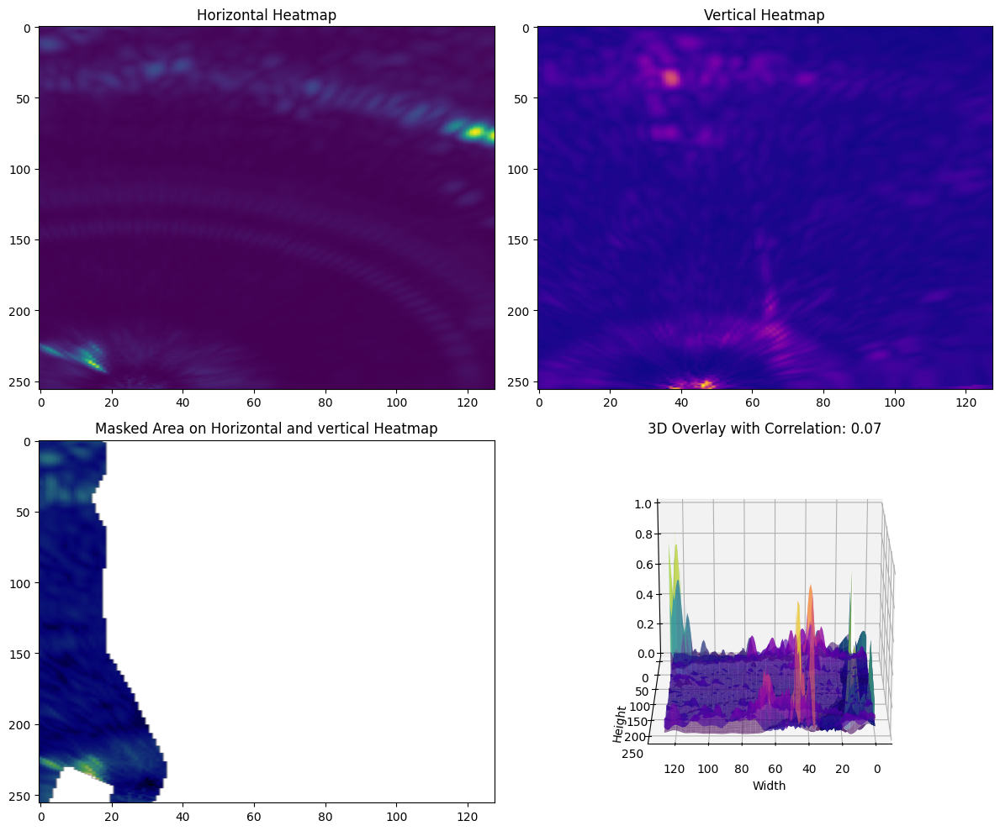

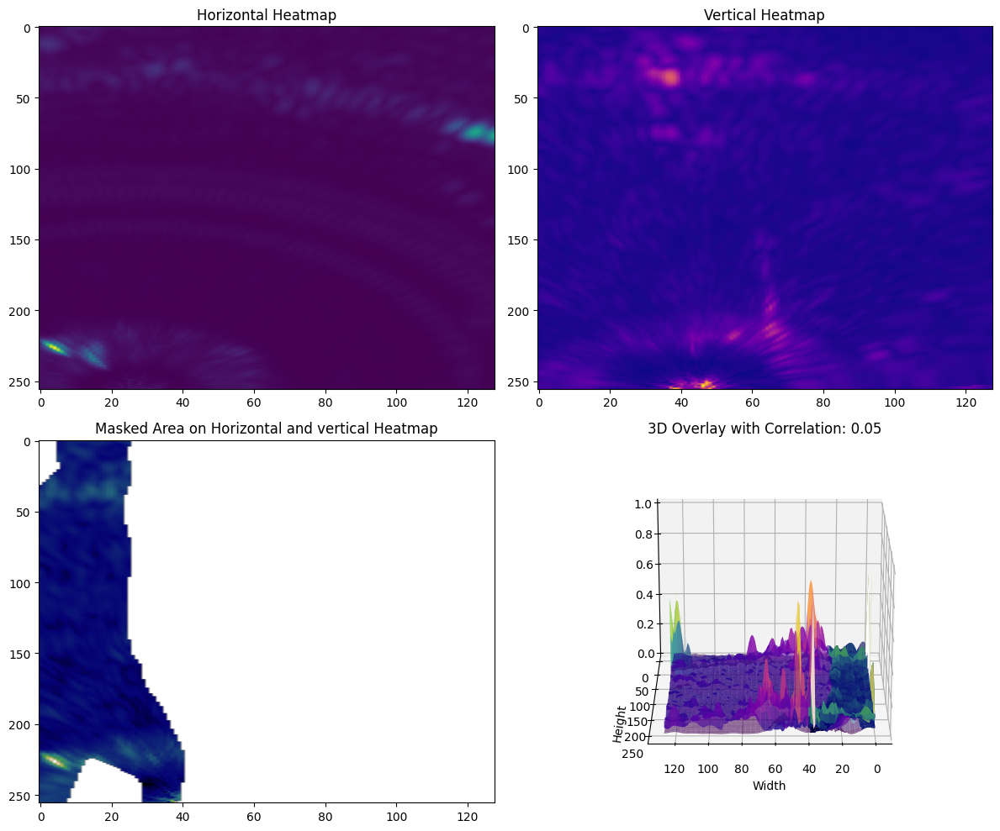

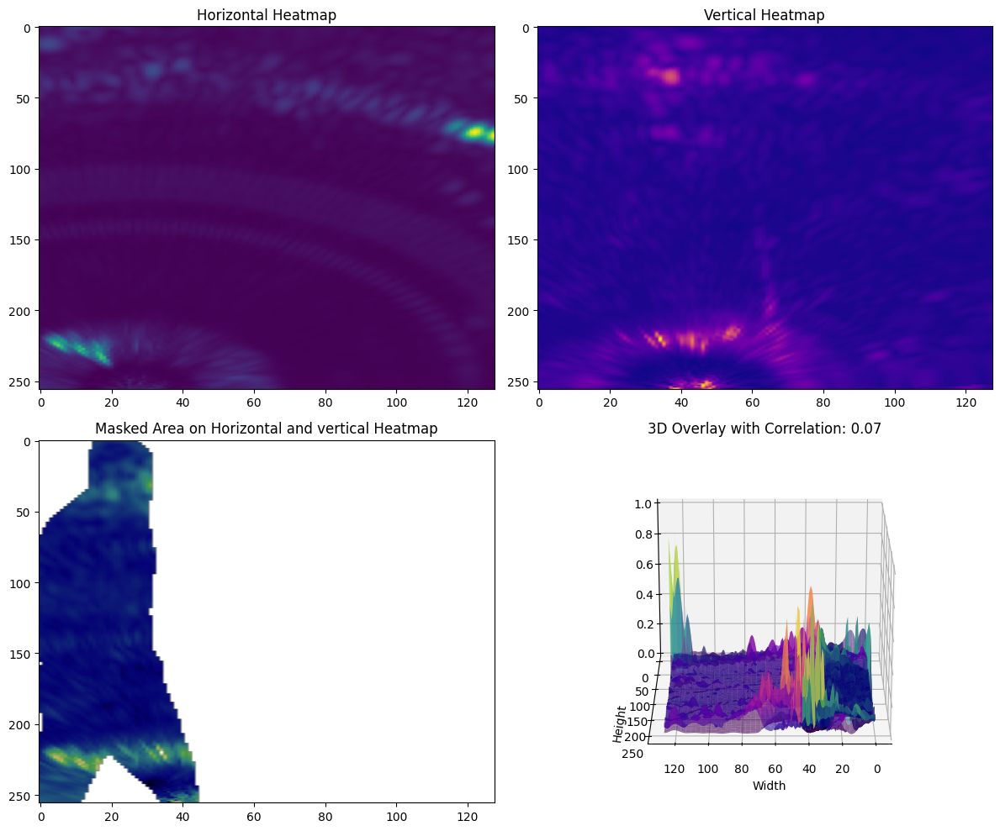

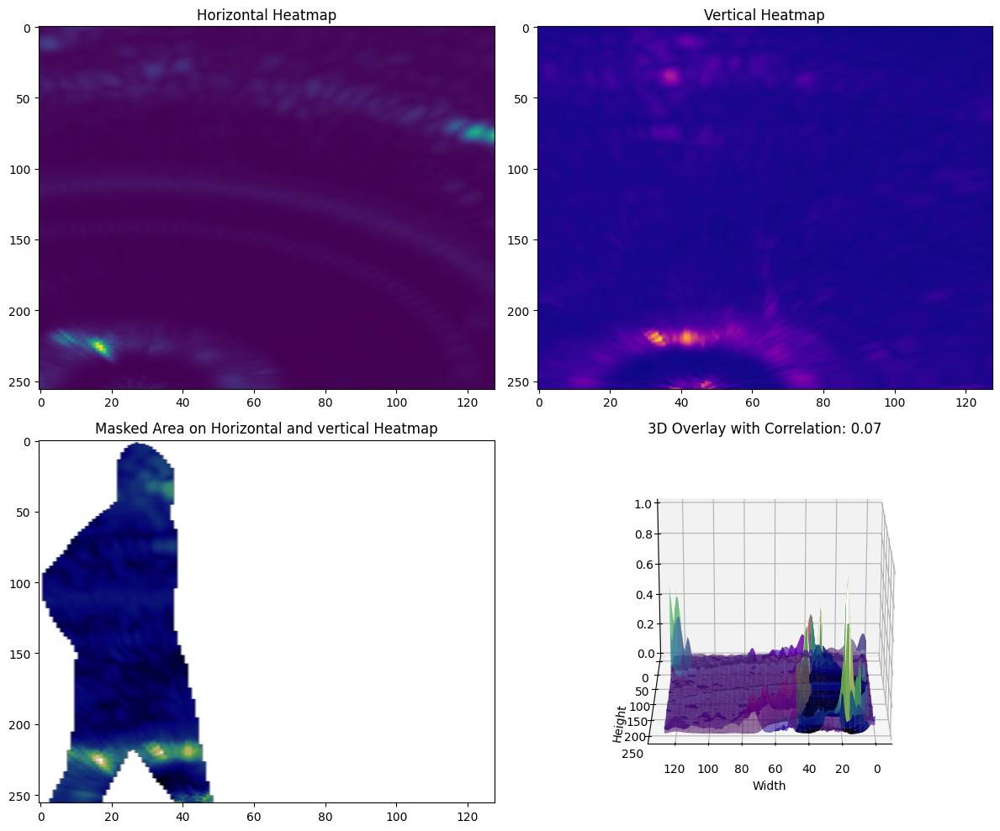

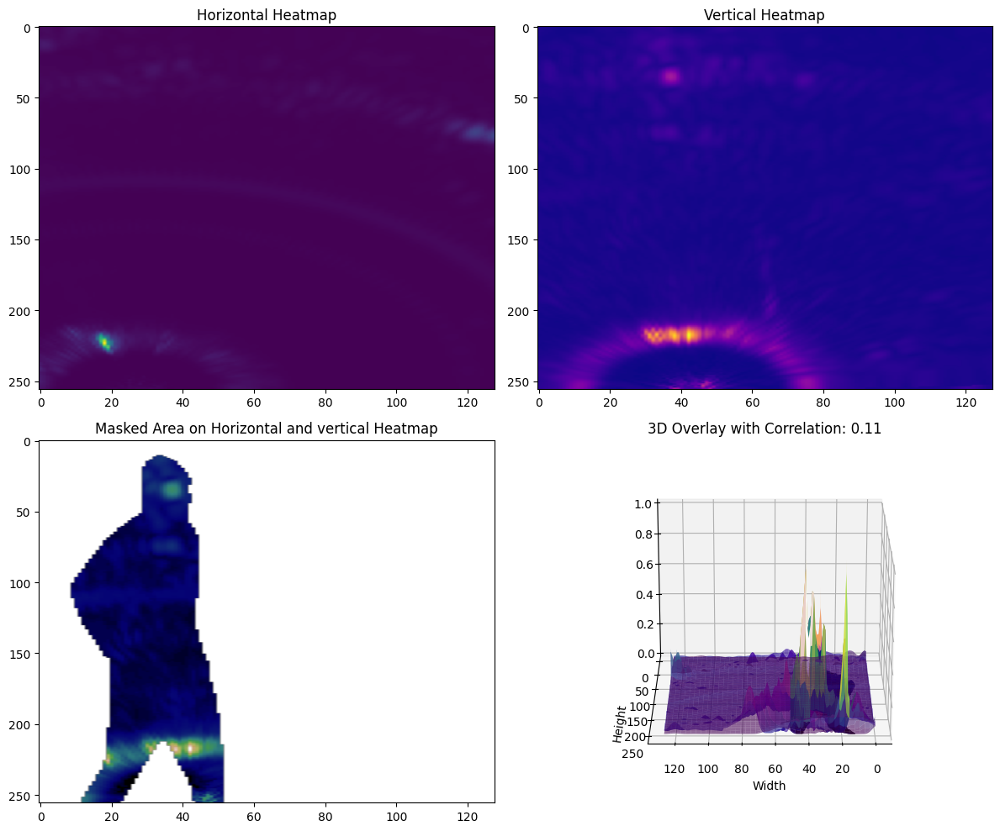

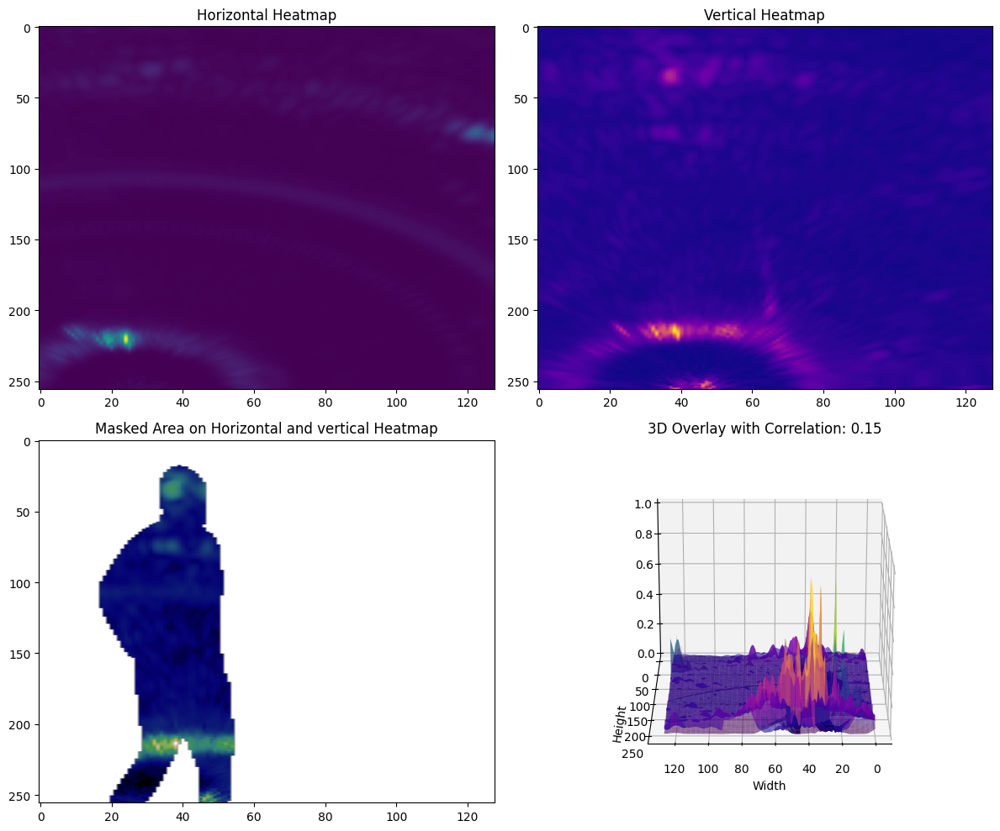

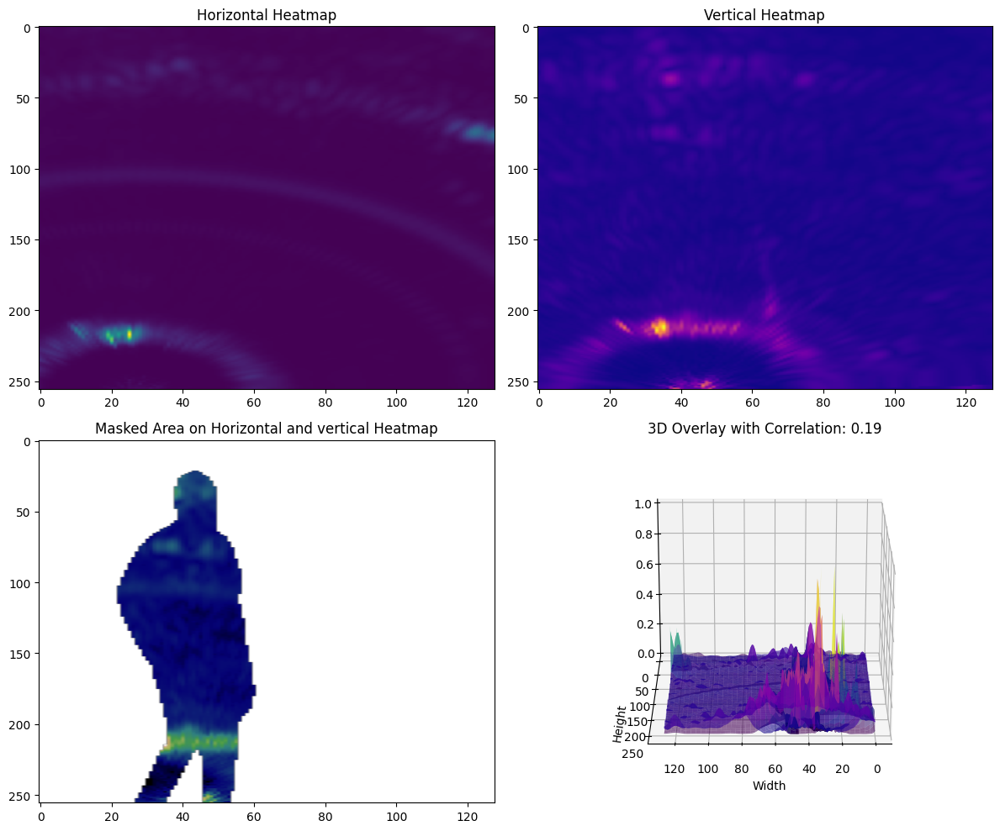

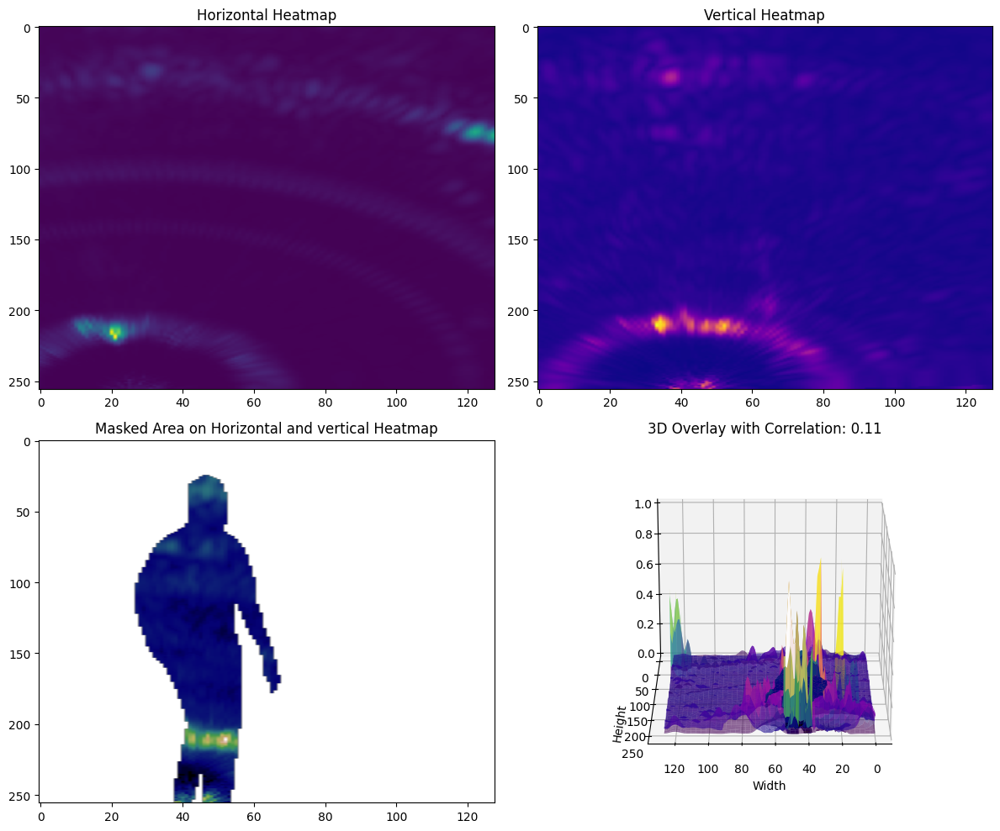

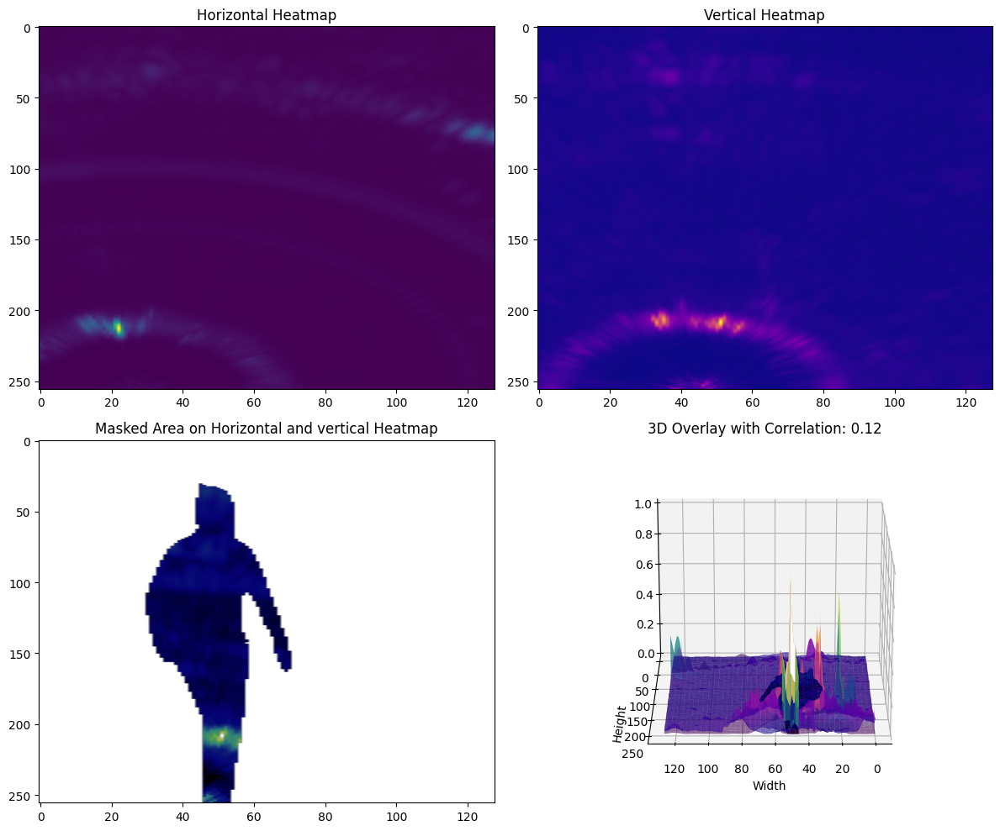

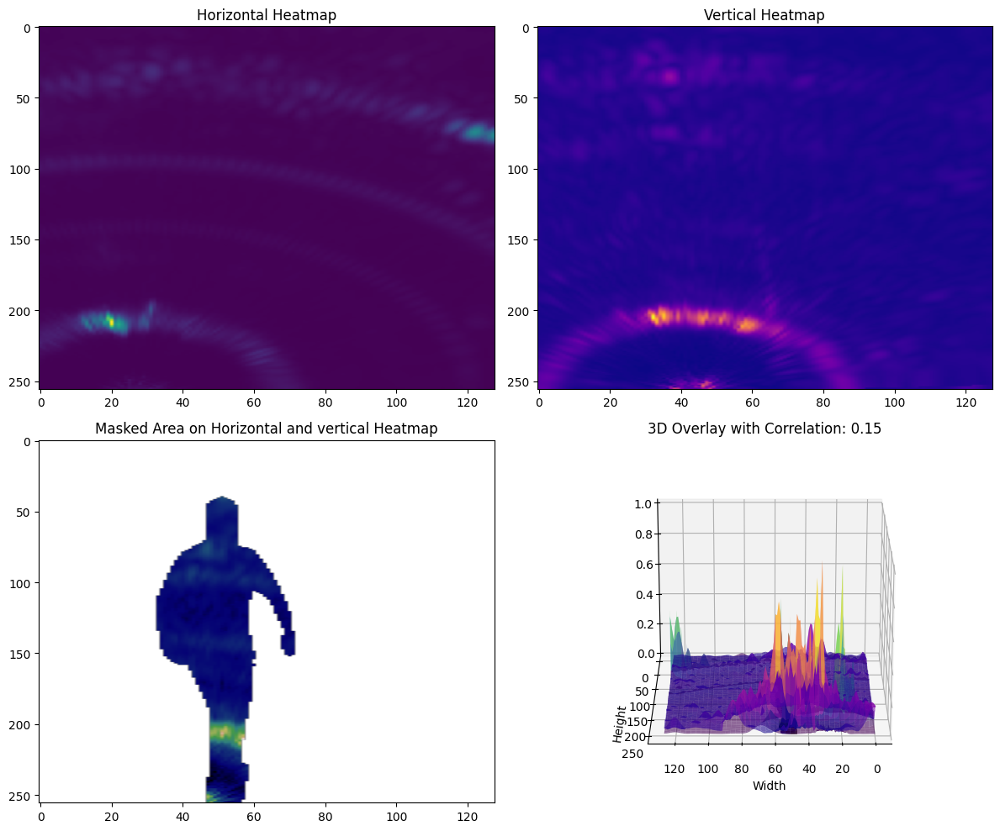

In [ ]:
for i in range(10):
  visualizeHeatmaps(i, df, save_path=f"heatmap_plot_Frame{i}.png")

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import resize

def computeFrameDifference(df):
    frame_diffs_hori = []
    frame_diffs_vert = []
    frameMaskDiff = []

    for i in range(1, 100):  # Process all frames
        prev_hori = df['filled_hori'][i - 1]
        curr_hori = df['filled_hori'][i]
        prev_vert = df['filled_vert'][i - 1]
        curr_vert = df['filled_vert'][i]
        prevMask = df['mask'][i - 1].astype(bool)
        currMask = df['mask'][i].astype(bool)

        # Compute absolute differences
        diff_hori = np.abs(curr_hori - prev_hori)
        diff_vert = np.abs(curr_vert - prev_vert)

        # Compute mask difference using XOR
        maskDiff = np.logical_xor(currMask, prevMask).astype(np.uint8)

        frame_diffs_hori.append(diff_hori)
        frame_diffs_vert.append(diff_vert)
        frameMaskDiff.append(maskDiff)

    return frame_diffs_hori, frame_diffs_vert, frameMaskDiff

def visualizeFrameDifferences(frame_diffs_hori, frame_diffs_vert, maskDiff, frame_idx):
    """
    Visualizes the frame difference at a given index, overlaying mask changes.
    """
    if frame_idx >= len(frame_diffs_hori):
        print(f"Frame index {frame_idx} out of range.")
        return

    diff_hori = frame_diffs_hori[frame_idx]
    diff_vert = frame_diffs_vert[frame_idx]
    mask_resized = resize(maskDiff[frame_idx][0], (256, 128), order=0, preserve_range=True, anti_aliasing=False)

    fig, ax = plt.subplots(figsize=(8, 8))

    # Plot heatmap difference
    ax.imshow(diff_hori + diff_vert, cmap='inferno', aspect='auto')
    # Overlay mask difference with transparency
    ax.imshow(mask_resized, cmap='Reds', alpha=0.3, aspect='auto')




    ax.set_title(f'Horizontal and Vertical Combined Change (Frame {frame_idx} to {frame_idx+1})')

    plt.show()


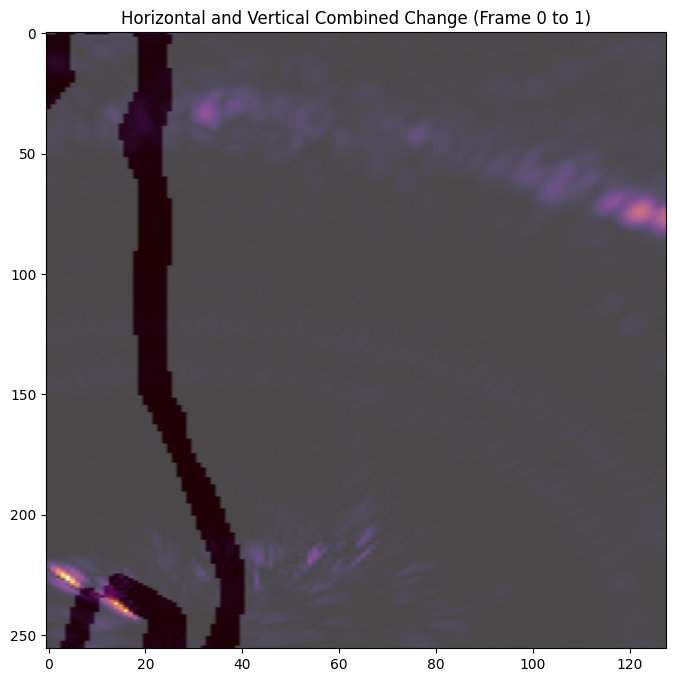

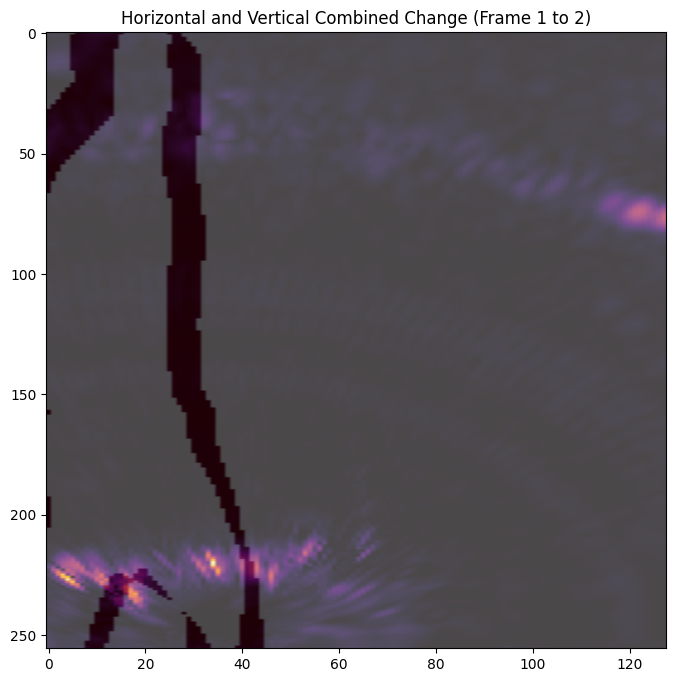

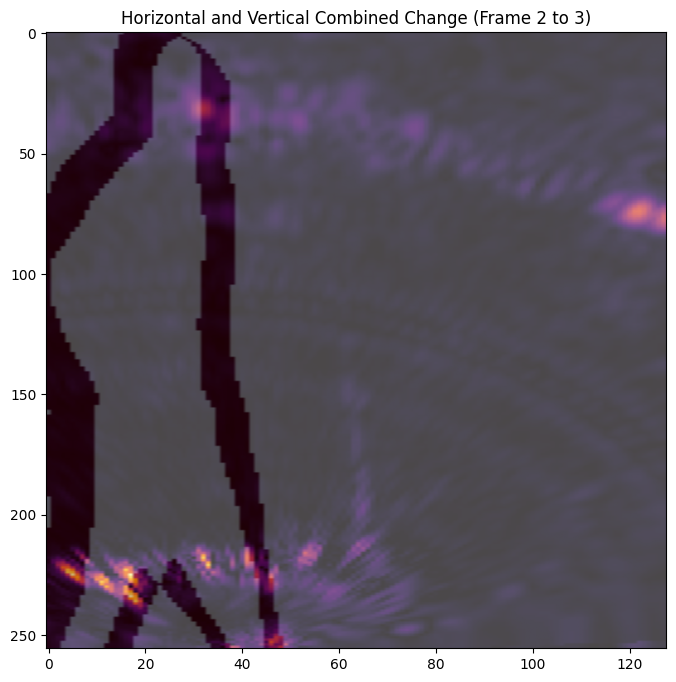

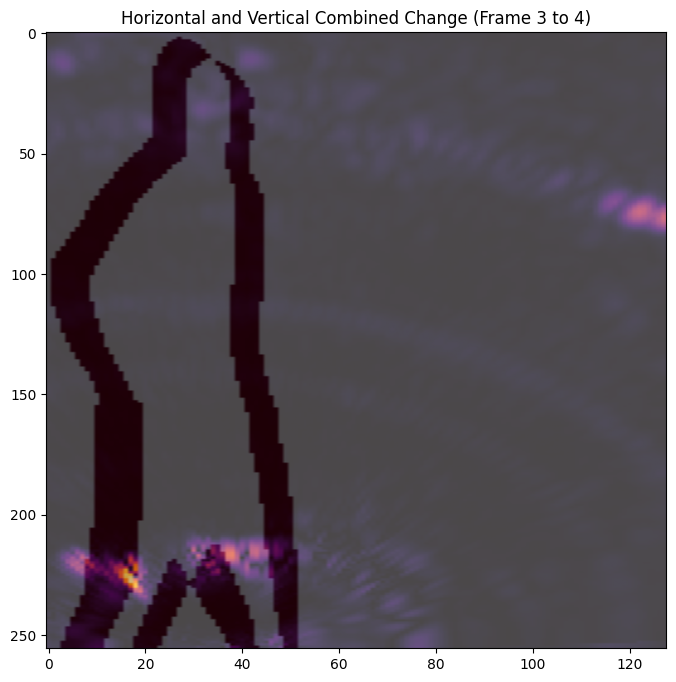

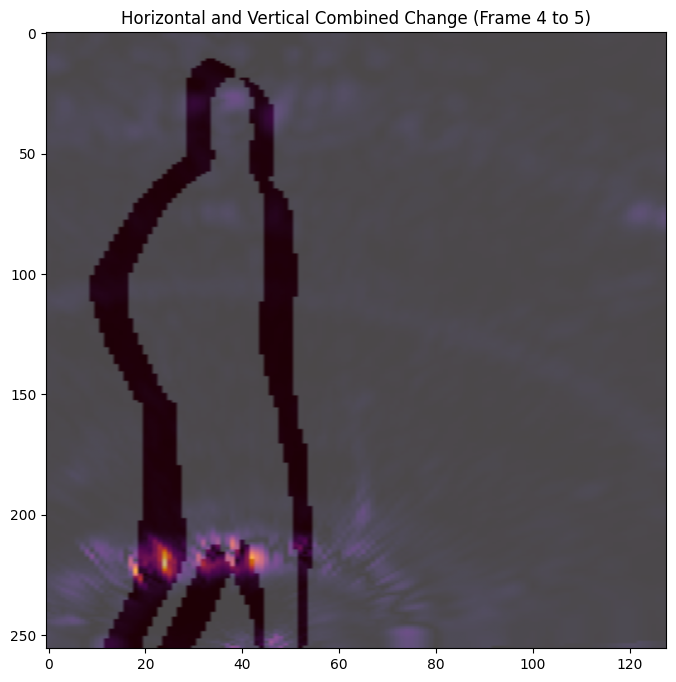

...

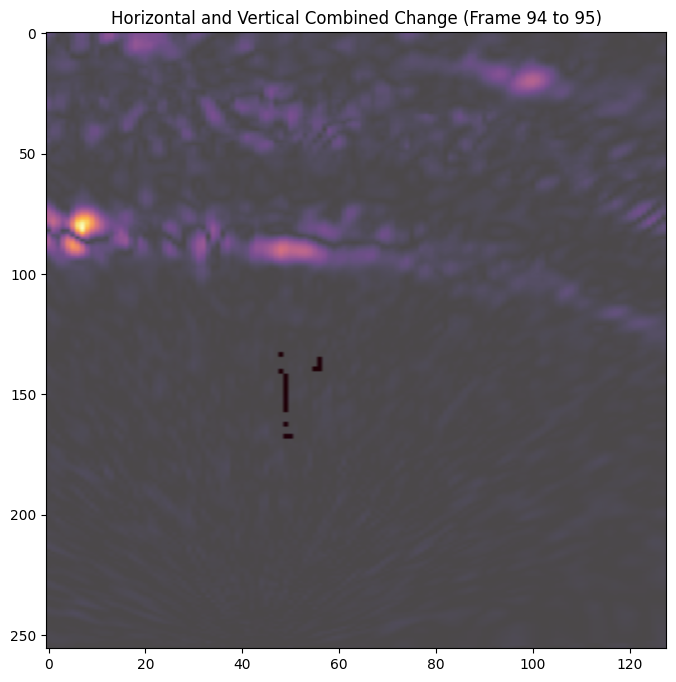

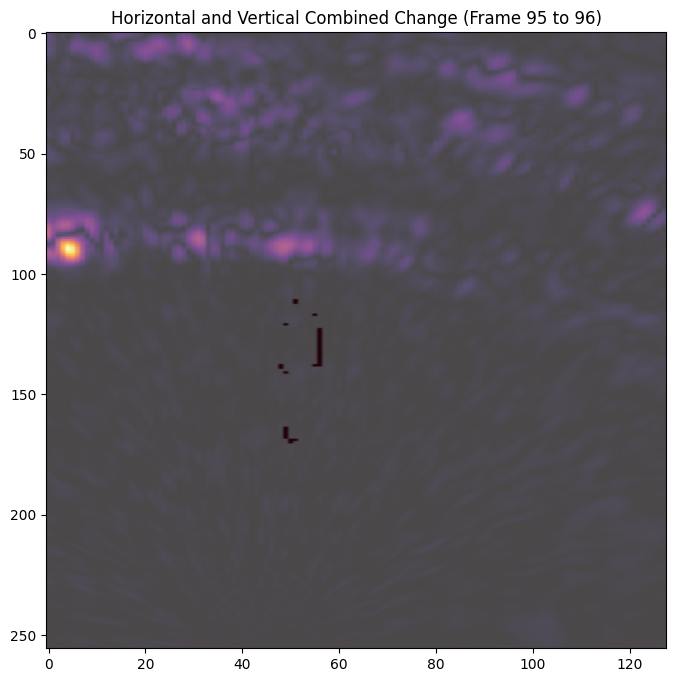

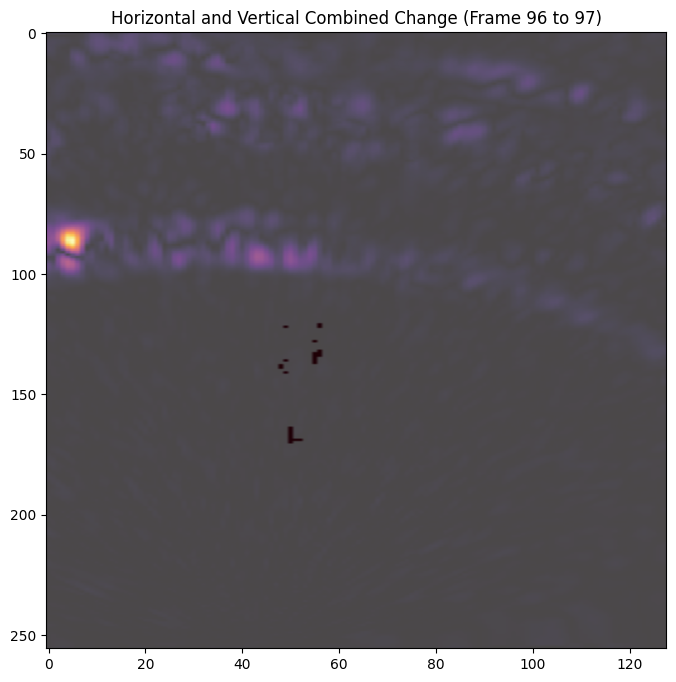

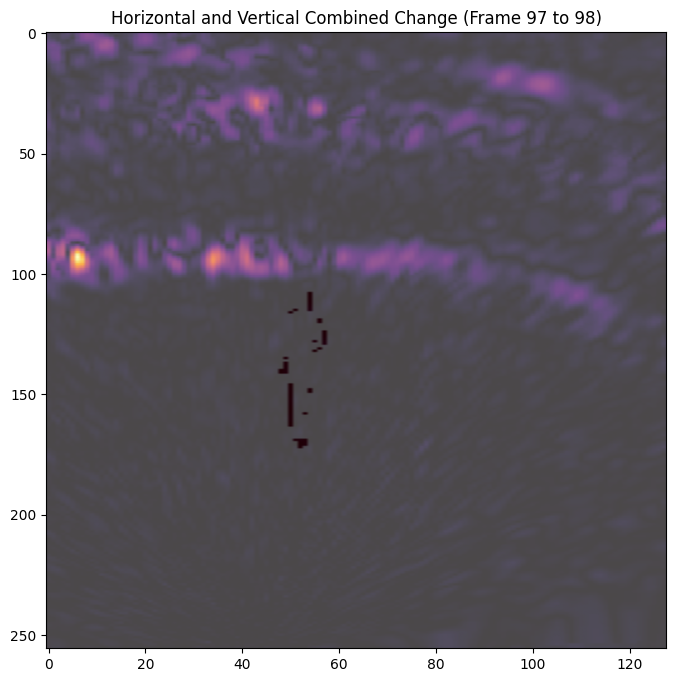

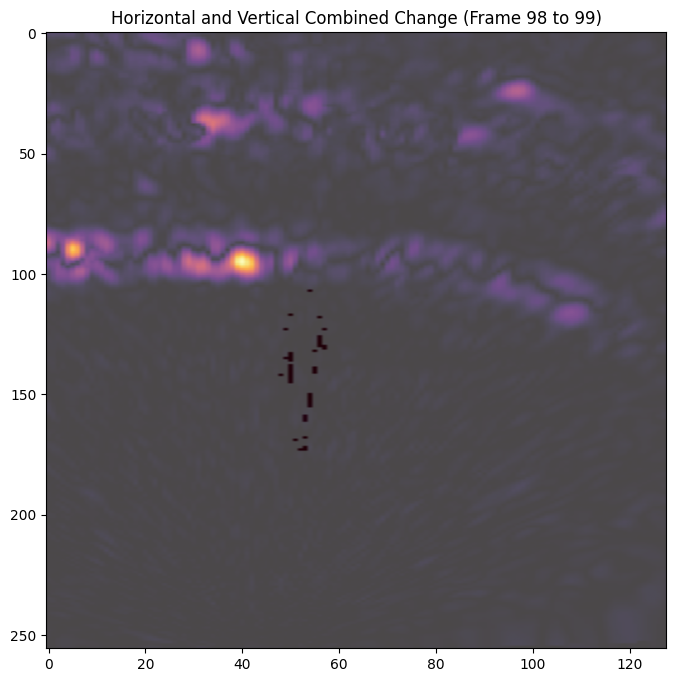

Frame index 99 out of range.


In [ ]:
frameDiffhori, frameDiffvert, maskDiff = computeFrameDifference(df)



for i in range(0, 100):
  visualizeFrameDifferences(frameDiffhori, frameDiffvert, maskDiff, frame_idx=i)

In [ ]:
# import numpy as np
# import pandas as pd
# from scipy.stats import pearsonr

# # Assuming `df` is your DataFrame with 'filled_hori' and 'filled_vert' columns containing filled heatmaps
# # Example DataFrame structure:
# # df = pd.DataFrame({'filled_hori': [hori1, hori2, ...], 'filled_vert': [vert1, vert2, ...]})

# # Initialize a list to store correlation values
# correlation_list = []

# # Loop through each row in the DataFrame
# for idx, row in df.iterrows():
#     hori = row['filled_hori']
#     vert = row['filled_vert']

#     # Flatten the heatmaps
#     hori_flat = hori.flatten()
#     vert_flat = vert.flatten()

#     # Calculate Pearson correlation
#     if len(hori_flat) > 0 and len(vert_flat) > 0:  # Ensure there are valid values
#         correlation, _ = pearsonr(hori_flat, vert_flat)
#         correlation_list.append(correlation)
#     else:
#         correlation_list.append(np.nan)  # If no valid values, store NaN

# # Calculate the average correlation (ignoring NaNs)
# average_correlation = np.nanmean(correlation_list)
# print(f"Average correlation between horizontal and vertical heatmaps: {average_correlation:.3f}")

NameError: name 'S' is not defined

In [ ]:
# import matplotlib.pyplot as plt
# import numpy as np
# import matplotlib.patches as patches

# # Create a figure with a larger size
# plt.figure(figsize=(12, 10))

# # Plot the heatmap
# plt.imshow(df['filled_vert'][10])

# # Define the top-left corner and bottom-right corner (in pixels)
# top_left = (253, 122)  # (y, x)
# bottom_right = (255, 127)  # (y, x)

# # Get the current axis
# ax = plt.gca()

# # Calculate width and height of the bounding box
# width = bottom_right[1] - top_left[1]  # x-direction (columns)
# height = bottom_right[0] - top_left[0]  # y-direction (rows)

# # Print bounding box parameters for debugging
# print(f"Bounding Box: x={top_left[1]}, y={top_left[0]}, width={width}, height={height}")

# # Add the rectangle to the plot
# bbox = patches.Rectangle(
#     (top_left[1], top_left[0]),
#     width, height,
#     linewidth=2,  # Increase line width
#     edgecolor='red',  # Change color to red for better contrast
#     linestyle='--'
# )
# ax.add_patch(bbox)

# # Define a margin around the bounding box for zooming
# margin = 10  # Adjust this value to control the zoom level

# # Set the axis limits to zoom around the bounding box
# plt.xlim([top_left[1] - margin, bottom_right[1] + margin])  # x-axis limits
# plt.ylim([bottom_right[0] + margin, top_left[0] - margin])  # y-axis limits (inverted)

# # Add grid lines
# plt.grid(True, color='white', linestyle='--', linewidth=0.5)

# # Display the heatmap with the bounding box
# plt.title('Zoomed Heatmap with Bounding Box')
# plt.show()

In [ ]:

# from scipy.ndimage import gaussian_filter

# def PreProcessVertHori(hori, vert, sigma=1):
#     ## Converting to NumPy arrays if they are Pandas Series
#     hori_filled = np.apply_along_axis(
#     lambda row: pd.Series(row).interpolate().fillna(0).to_numpy(),
#     axis=1,  # Apply along rows
#     arr=df['hori'][0]
#     )

#     hori_filled = np.apply_along_axis(
#     lambda row: pd.Series(row).interpolate().fillna(0).to_numpy(),
#     axis=1,  # Apply along rows
#     arr=df['hori'][0]
#     )


#     # ## Checking NaNs for horizontal heatmaps
#     # ## filling zero in that place for simplicity
#     # if np.isnan(hori).any():
#     #     horiFilled = np.where(np.isnan(hori), 0.0, hori)
#     # else:
#     #     horiFilled = hori

#     # ## Checking NaNs for vertical heatmaps
#     # ## filling zero in that place for simplicity
#     # if np.isnan(vert).any():
#     #     vertFilled = np.where(np.isnan(vert), 0.0, vert)
#     # else:
#     #     vertFilled = vert

#     ## Normalizing heatmaps to [0, 1]
#     def normalize(heatmap):
#         min_val = np.min(heatmap)
#         max_val = np.max(heatmap)
#         if min_val == max_val:
#              ## Returning zeros to avoid division by zero
#             return np.zeros_like(heatmap)
#         return (heatmap - min_val) / (max_val - min_val)
#     ## App;ying Gaussian filter to horizontal and vertical heatmaps
#     horiTemp = gaussian_filter(horiFilled, sigma=sigma)
#     vertTemp = gaussian_filter(horiFilled, sigma=sigma)

#     ## Normalizing the heatmaps
#     # hori_norm = normalize(horiTemp)
#     # vert_norm = normalize(vertTemp)

#     return horiTemp, vertTemp


In [ ]:
# # df['hori_filled'] = df['hori'].apply(
# #     lambda img: pd.DataFrame(img)
# #         .interpolate(axis=0, limit_direction='both')
# #         .interpolate(axis=1, limit_direction='both')
# #         .fillna(0)
# #         .to_numpy()
# #         .reshape(256, 128)  # Ensure shape remains (256, 128)
# # )
# # import cv2
# # import numpy as np

# # def fill_heatmap_gaussian(img, sigma=1):
# #     filled = np.nan_to_num(img, nan=0)  # Convert NaNs to 0 for processing
# #     return cv2.GaussianBlur(filled, (5, 5), sigma)

# # df['hori_filled'] = df['hori'].apply(fill_heatmap_gaussian)


# import cv2


# def fillNorm(img):
#     ## Filling NaNs with 0s first to avoid erroes
#     img_filled = np.nan_to_num(img, nan=0)

#     img_normalized = cv2.normalize(img_filled, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX)

#     return img_normalized


# df['hori_filled_normalized'] = df['hori'].apply(fillNorm)



In [ ]:
# ## Filling vertical heatmaps
# df['vert_filled_normalized'] = df['vert'].apply(fillNorm)


In [ ]:
# ## Plotting the normalised heatmaps to check the results
# plot_heatmaps_and_annotations(df['hori_filled_normalized'][0], df['vert_filled_normalized'][0], mask, bbox_i, kp, connections)

In [ ]:
import cv2
import numpy as np
import pandas as pd

def preProcessY_train(kp, bbox_i, mask):
    new_height, new_width = 256, 128

    # Initialize updated masks array
    updated_masks = np.zeros((mask.shape[0], new_height, new_width), dtype=np.uint8)

    # Scaling factors
    scaleX = new_width / mask.shape[2]   # Width scaling
    scaleY = new_height / mask.shape[1]  # Height scaling

    # Copy keypoints and bounding boxes
    updated_kp = kp.copy()
    updated_bbox_i = bbox_i.copy()

    for j in range(mask.shape[0]):
        # Resize mask (boolean to uint8)
        updated_masks[j] = cv2.resize(mask[j].astype(np.uint8), (new_width, new_height), interpolation=cv2.INTER_NEAREST)

        # Scale bounding boxes
        updated_bbox_i[j, :4] = (bbox_i[j, :4] * np.array([scaleX, scaleY, scaleX, scaleY])).astype(int)

        # Scale keypoints
        updated_kp[j, :, 0] *= scaleX
        updated_kp[j, :, 1] *= scaleY

    return updated_kp, updated_bbox_i, updated_masks

# Initialize lists to store processed data
scaled_kp_list, scaled_bbox_list, scaled_mask_list = [], [], []

# Efficient iteration using zip()
for kp, bbox_i, mask in zip(df['kp'], df['bbox_i'], df['mask']):
    scaledKp, scaledBbox_i, scaledMask = preProcessY_train(kp, bbox_i, mask)

    # Append results to lists
    scaled_kp_list.append(scaledKp)
    scaled_bbox_list.append(scaledBbox_i)
    scaled_mask_list.append(scaledMask)

# Convert lists to a DataFrame (efficient single-step creation)
YY = pd.DataFrame({
    "scaledKp": scaled_kp_list,
    "scaledBbox_i": scaled_bbox_list,
    "scaledMask": scaled_mask_list
})


In [ ]:
def stackFramesWithScaledMask(df, YY, maxframes=900, use_half=False, use_first_half=True):
    # Use half of the data if use_half is True
    if use_half:
        half_idx = len(df) // 2
        if use_first_half:
            df = df.iloc[:half_idx]  # Use the first half
        else:
            df = df.iloc[half_idx:]  # Use the second half

    n = len(df) - 1
    stack = [None] * n  # Preallocate list for feature sequences
    mask_stack = [None] * n  # Preallocate list for masks
    count = 0

    # Mapping index of df to scaled mask from YY
    scaled_mask_dict = {i: YY.loc[i, 'scaledMask'] for i in range(len(YY))}

    for (_, prevRow), (_, currRow) in zip(df[:-1].iterrows(), df[1:].iterrows()):
        seq_curr, frame_curr = map(int, currRow['timeStep'].split('_'))
        seq_prev, frame_prev = map(int, prevRow['timeStep'].split('_'))

        # Check if both timeStep are from the same sequence and frames are consecutive
        if seq_curr == seq_prev and frame_curr == frame_prev + 1:
            try:
                # Stack features (filled_hori and filled_vert)
                stackedFeatures = np.stack([
                    [prevRow['filled_hori'], prevRow['filled_vert']],
                    [currRow['filled_hori'], currRow['filled_vert']]
                ], axis=0)  # Shape: (2, 2)

                # Fetch the scaled masks for prevRow and currRow from YY DataFrame
                prev_mask = scaled_mask_dict.get(prevRow.name, None)
                curr_mask = scaled_mask_dict.get(currRow.name, None)

                if prev_mask is not None and curr_mask is not None:
                    # Stack mask (ensure it's compatible with LSTM input)
                    maskStack = np.stack([prev_mask, curr_mask], axis=0)  # Shape: (2, ...)

                    stack[count] = stackedFeatures
                    mask_stack[count] = maskStack
                    count += 1
                else:
                    print(f"Skipping due to missing scaled mask for indices {prevRow.name} or {currRow.name}")

            except Exception as e:
                print(f"Skipping due to error: {e}")  # Debugging for shape mismatches

    # Convert lists to NumPy arrays
    stack = np.array(stack[:count])
    mask_stack = np.array(mask_stack[:count])

    return stack, mask_stack


stack, mask_stack = stackFramesWithScaledMask(df, YY, use_half=True, use_first_half=True)
print(stack.shape)
print(mask_stack.shape)

(8788, 2, 2, 256, 128)
(8788, 2, 1, 256, 128)


In [ ]:
print(stack.shape)

(8788, 2, 2, 256, 128)


In [ ]:
# for seq, frame in groupSeq.items():
#   print(seq)
#   print("############")
#   print(frame)
#   break

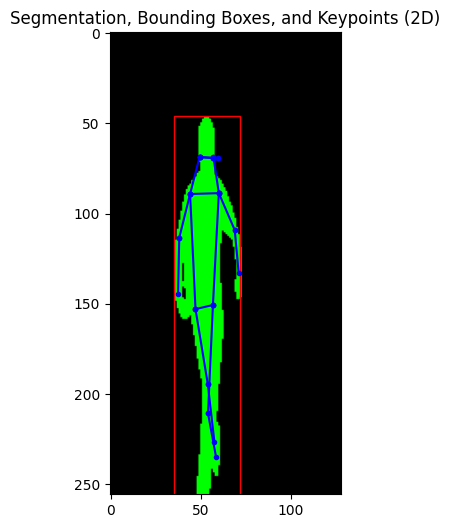

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.patches as patches


## Function to plot normalised masks, bboxes and keypoints
def processedYYplotter(mask, bbox_i, kp):

    ## Plotting segmentation, bounding boxes, and keypoints
    fig = plt.figure(figsize=(10, 6))
    ax = fig.add_subplot(1, 1, 1)
    img = np.zeros((256, 128, 3), dtype=np.uint8)


    for j in range(mask.shape[0]):

        ## Applying segmentation mask
        img[mask[j, :, :]==1] = (0, 255, 0)
        ## BBoxes
        x1, y1, x2, y2 = bbox_i[j, :4]
        width = x2 - x1
        height = y2 - y1
        rect = patches.Rectangle((x1, y1), width, height, linewidth=1, edgecolor='r', facecolor='none')
        ax.add_patch(rect)

        ## Plotting keypoints
        for connection in connections:
            x = kp[j, connection, 0]
            y = kp[j, connection, 1]
            ax.plot(x, y, color='b', marker='.')

    ax.imshow(img)
    ax.set_title('Segmentation, Bounding Boxes, and Keypoints (2D)')
    plt.show()


scaledKp, scaledBbox_i, scaledMask = YY.iloc[10, :]
processedYYplotter(scaledMask, scaledBbox_i, scaledKp)

## 3. Model Fitting

In [ ]:
# import torch
# import torch.nn as nn

# class ConvLSTMCell(nn.Module):
#     def __init__(self, input_dim, hidden_dim, kernel_size, bias=True):
#         super(ConvLSTMCell, self).__init__()
#         self.input_dim = input_dim
#         self.hidden_dim = hidden_dim
#         self.kernel_size = kernel_size
#         self.padding = kernel_size[0] // 2, kernel_size[1] // 2
#         self.bias = bias

#         self.conv = nn.Conv2d(
#             in_channels=self.input_dim + self.hidden_dim,
#             out_channels=4 * self.hidden_dim,  # 4 for input, forget, cell, and output gates
#             kernel_size=self.kernel_size,
#             padding=self.padding,
#             bias=self.bias
#         )

#     def forward(self, input_tensor, cur_state):
#         h_cur, c_cur = cur_state

#         combined = torch.cat([input_tensor, h_cur], dim=1)  # Concatenate along channel axis
#         combined_conv = self.conv(combined)

#         cc_i, cc_f, cc_o, cc_g = torch.split(combined_conv, self.hidden_dim, dim=1)
#         i = torch.sigmoid(cc_i)
#         f = torch.sigmoid(cc_f)
#         o = torch.sigmoid(cc_o)
#         g = torch.tanh(cc_g)

#         c_next = f * c_cur + i * g
#         h_next = o * torch.tanh(c_next)

#         return h_next, c_next

#     def init_hidden(self, batch_size, image_size):
#         height, width = image_size
#         return (
#             torch.zeros(batch_size, self.hidden_dim, height, width, device=self.conv.weight.device),
#             torch.zeros(batch_size, self.hidden_dim, height, width, device=self.conv.weight.device)
#         )


# class ConvLSTM(nn.Module):
#     def __init__(self, input_dim, hidden_dim, kernel_size, num_layers, batch_first=False, bias=True):
#         super(ConvLSTM, self).__init__()
#         self.input_dim = input_dim
#         self.hidden_dim = hidden_dim
#         self.kernel_size = kernel_size
#         self.num_layers = num_layers
#         self.batch_first = batch_first
#         self.bias = bias

#         self.cell_list = nn.ModuleList()
#         for i in range(self.num_layers):
#             cur_input_dim = self.input_dim if i == 0 else self.hidden_dim
#             self.cell_list.append(ConvLSTMCell(
#                 input_dim=cur_input_dim,
#                 hidden_dim=self.hidden_dim,
#                 kernel_size=self.kernel_size,
#                 bias=self.bias
#             ))

#     def forward(self, input_tensor, hidden_state=None):
#         if not self.batch_first:
#             # (timesteps, batch, channels, height, width) -> (batch, timesteps, channels, height, width)
#             input_tensor = input_tensor.permute(1, 0, 2, 3, 4)

#         batch_size, timesteps, _, height, width = input_tensor.size()

#         if hidden_state is None:
#             hidden_state = self._init_hidden(batch_size, (height, width))

#         layer_output_list = []
#         last_state_list = []

#         cur_layer_input = input_tensor

#         for layer_idx in range(self.num_layers):
#             h, c = hidden_state[layer_idx]
#             output_inner = []
#             for t in range(timesteps):
#                 h, c = self.cell_list[layer_idx](input_tensor=cur_layer_input[:, t, :, :, :], cur_state=[h, c])
#                 output_inner.append(h)

#             layer_output = torch.stack(output_inner, dim=1)
#             cur_layer_input = layer_output

#             layer_output_list.append(layer_output)
#             last_state_list.append([h, c])

#         if not self.batch_first:
#             layer_output_list = [output.permute(1, 0, 2, 3, 4) for output in layer_output_list]

#         return layer_output_list, last_state_list

#     def _init_hidden(self, batch_size, image_size):
#         init_states = []
#         for i in range(self.num_layers):
#             init_states.append(self.cell_list[i].init_hidden(batch_size, image_size))
#         return init_states

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models

class MaskRegressorWithoutConvLSTM(nn.Module):
    def __init__(self, pretrained=True):
        super(MaskRegressorWithoutConvLSTM, self).__init__()

        ## Loading the pretrained ResNet-50 model
        resnet = models.resnet50(weights=pretrained)

        ## Modify the first convolutional layer to accept 4 input channels (2 timesteps × 2 channels each)
        resnet.conv1 = nn.Conv2d(4, 64, kernel_size=7, stride=2, padding=3, bias=False)

        ## Encoder: ResNet-50 as backbone
        self.encoder = nn.Sequential(
            resnet.conv1,   # (64, H/2, W/2)
            resnet.bn1,
            resnet.relu,
            resnet.maxpool, # (64, H/4, W/4)
            resnet.layer1,  # (256, H/4, W/4)
            resnet.layer2,  # (512, H/8, W/8)
            resnet.layer3,  # (1024, H/16, W/16)
            resnet.layer4   # (2048, H/32, W/32)
        )

        ## Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(2048, 1024, kernel_size=4, stride=2, padding=1, output_padding=0), ## (1024, H/16, W/16)
            nn.BatchNorm2d(1024),
            nn.ReLU(),
            nn.Dropout(p=0.3),

            nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (512, H/8, W/8)
            nn.BatchNorm2d(512),
            nn.ReLU(),
            nn.Dropout(p=0.3),

            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1, output_padding=0),  ## (256, H/4, W/4)
            nn.BatchNorm2d(256),
            nn.ReLU(),
            nn.Dropout(p=0.3),

            nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1, output_padding=0),   ## (64, H/2, W/2)
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.Dropout(p=0.3),

            nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1, output_padding=0),    ## (32, H, W)
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.Conv2d(32, 2, kernel_size=3, padding=1),  ## Output two masks for two timesteps (2, H, W)
            nn.Sigmoid()
        )

    def forward(self, x):
        # x shape = batch, timesteps, channels, height, width
        batch_size, timesteps, C, H, W = x.size()

        x = x.view(batch_size, timesteps * C, H, W)


        x = self.encoder(x)  # Encoder output shape: (batch, 2048, H/32, W/32)
        x = self.decoder(x)  # Decoder output shape: (batch, 2, H, W)


        x = x.unsqueeze(2)

        return x


In [ ]:
# !pip install efficientnet-pytorch


In [ ]:
# from efficientnet_pytorch import EfficientNet

# class MaskRegressorWithEfficientNet(nn.Module):
#     def __init__(self, pretrained=True):
#         super(MaskRegressorWithEfficientNet, self).__init__()

#         # Load EfficientNet
#         self.efficientnet = EfficientNet.from_pretrained('efficientnet-b0')  # You can choose any variant

#         # Modify the first convolutional layer to accept 4 input channels
#         self.efficientnet._conv_stem = nn.Conv2d(4, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)

#         # Decoder part remains the same as your previous code
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(1280, 1024, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(1024),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),
#             nn.ConvTranspose2d(1024, 512, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(512),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),
#             nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(256),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),
#             nn.ConvTranspose2d(256, 64, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(64),
#             nn.ReLU(),
#             nn.Dropout(p=0.3),
#             nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1),
#             nn.BatchNorm2d(32),
#             nn.ReLU(),
#             nn.Conv2d(32, 2, kernel_size=3, padding=1),
#             nn.Sigmoid()
#         )

#     def forward(self, x):
#         batch_size, timesteps, C, H, W = x.size()
#         x = x.view(batch_size, timesteps * C, H, W)

#         # Forward pass through EfficientNet
#         x = self.efficientnet.extract_features(x)  # EfficientNet feature extraction

#         # Decoder
#         x = self.decoder(x)

#         x = x.unsqueeze(2)
#         return x


In [ ]:
# !pip install torchinfo


In [ ]:
# from torchinfo import summary

# model = MaskRegressorWithConvLSTM()
# input_tensor = torch.randn(32, 2, 2, 256, 128)
# summary(model, input_size=(2, 5, 2, 256, 128))


In [ ]:
import torch
import torch.nn.functional as F

def iou_loss(pred, target, smooth=1e-6):
    """
    Compute the IoU (Intersection over Union) loss.

    pred: predicted binary mask (Tensor of shape [batch_size, 1, height, width])
    target: ground truth binary mask (Tensor of shape [batch_size, 1, height, width])
    smooth: a small value to avoid division by zero.

    Returns: IoU loss (lower is better)
    """
    # Flatten the tensors
    pred = pred.view(-1)
    target = target.view(-1)

    # Intersection and union
    intersection = torch.sum(pred * target)
    union = torch.sum(pred) + torch.sum(target) - intersection

    # IoU
    iou = (intersection + smooth) / (union + smooth)

    # IoU loss is 1 - IoU, since we want to minimize the difference
    return 1 - iou

# Example usage in the training loop
criterion = iou_loss  # Use IoU loss instead of BCE


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 200MB/s]
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch [1/20], Train Loss: 0.1649, Val Loss: 0.7008
Epoch [2/20], Train Loss: 0.0641, Val Loss: 0.6957
Epoch [3/20], Train Loss: 0.0586, Val Loss: 0.6943
Epoch [4/20], Train Loss: 0.0543, Val Loss: 0.6915
Epoch [5/20], Train Loss: 0.0517, Val Loss: 0.6923
Epoch [6/20], Train Loss: 0.0500, Val Loss: 0.6913
Epoch [7/20], Train Loss: 0.0483, Val Loss: 0.6908
Epoch [8/20], Train Loss: 0.0473, Val Loss: 0.6903
Epoch [9/20], Train Loss: 0.0454, Val Loss: 0.6907
Epoch [10/20], Train Loss: 0.0446, Val Loss: 0.6907
Epoch [11/20], Train Loss: 0.0432, Val Loss: 0.6894
Epoch [12/20], Train Loss: 0.0423, Val Loss: 0.6898
Epoch [13/20], Train Loss: 0.0413, Val Loss: 0.6888
Epoch [14/20], Train Loss: 0.0398, Val Loss: 0.6891
Epoch [15/20], Train Loss: 0.0388, Val Loss: 0.6894
Epoch [16/20], Train Loss: 0.0383, Val Loss: 0.6882
Epoch [17/20], Train Loss: 0.0369, Val Loss: 0.6888
Epoch [18/20], Train Loss: 0.0356, Val Loss: 0.6879
Epoch [19/20], Train Loss: 0.0345, Val Loss: 0.6882
Epoch [20/20], Train 

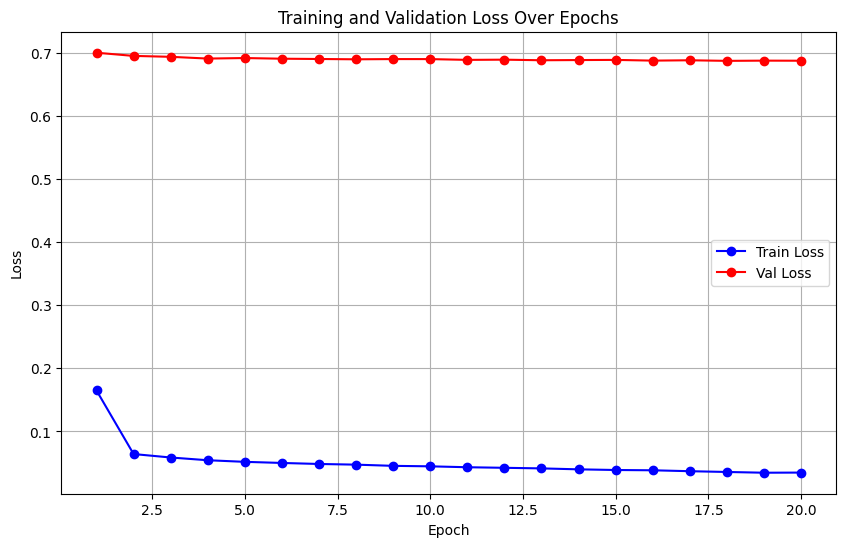

In [ ]:
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset, random_split
import matplotlib.pyplot as plt  # For plotting

# Assuming stack and mask_stack are already loaded as NumPy arrays
# stack shape: (8788, 2, 256, 128)
# mask_stack shape: (8788, 2, 256, 128)

## Converting NumPy arrays to PyTorch tensors
stack_tensor = torch.from_numpy(stack).float()  # Convert to float tensor
mask_stack_tensor = torch.from_numpy(mask_stack).float()  # Convert to float tensor

## Moving tensors to the GPu
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
stack_tensor = stack_tensor.to(device)
mask_stack_tensor = mask_stack_tensor.to(device)

dataset = TensorDataset(stack_tensor, mask_stack_tensor)


train_size = int(0.7 * len(dataset))
val_size = len(dataset) - train_size
train_dataset, val_dataset = random_split(dataset, [train_size, val_size])

### Creating DataLoaders for training and validation
batch_size = 32
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

model = MaskRegressorWithoutConvLSTM().to(device)

## loss function and optimizer
criterion = nn.BCELoss()  # Binary Cross-Entropy Loss for mask segmentation
optimizer = optim.Adam(model.parameters(), lr=0.001)

scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode='min', factor=0.5, patience=3, verbose=True)


num_epochs = 20  # BCE for 10 epochs was Epoch [10/10], Train Loss: 0.0364, Val Loss: 0.0379?

# Lists to store loss values for plotting
train_losses = []
val_losses = []

# Training loop
for epoch in range(num_epochs):
    model.train()  # Set the model to training mode
    epoch_train_loss = 0.0

    # Mini-batch training
    for inputs, targets in train_loader:
        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)

        # Compute loss
        loss = criterion(outputs, targets)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        # Accumulate loss for the epoch
        epoch_train_loss += loss.item()

    # Compute average training loss for the epoch
    epoch_train_loss /= len(train_loader)
    train_losses.append(epoch_train_loss)

    # Validation phase
    model.eval()  ## Setting the model to evaluation mode
    epoch_val_loss = 0.0

    with torch.no_grad():  # Disable gradient calculation for validation
        for inputs, targets in val_loader:
            # Forward pass
            outputs = model(inputs)
            # Apply sigmoid to the output
            outputs = torch.sigmoid(outputs)

            # Compute loss
            loss = criterion(outputs, targets)

            # Accumulate validation loss
            epoch_val_loss += loss.item()

    # Compute average validation loss for the epoch
    epoch_val_loss /= len(val_loader)
    val_losses.append(epoch_val_loss)

    # Print losses for the epoch
    print(f"Epoch [{epoch + 1}/{num_epochs}], Train Loss: {epoch_train_loss:.4f}, Val Loss: {epoch_val_loss:.4f}")

# Plot the training and validation loss curves
plt.figure(figsize=(10, 6))
plt.plot(range(1, num_epochs + 1), train_losses, marker="o", linestyle="-", color="b", label="Train Loss")
plt.plot(range(1, num_epochs + 1), val_losses, marker="o", linestyle="-", color="r", label="Val Loss")
plt.title("Training and Validation Loss Over Epochs")
plt.xlabel("Epoch")
plt.ylabel("Loss")
plt.legend()
plt.grid(True)
plt.show()

# Save the model
torch.save(model.state_dict(), "mask_regressor_with_convlstm.pth_IOU")

In [ ]:
print(targets.shape)

In [ ]:
# import tensorflow as tf
# tf.keras.backend.clear_session()


In [ ]:
predicted_mask.shape

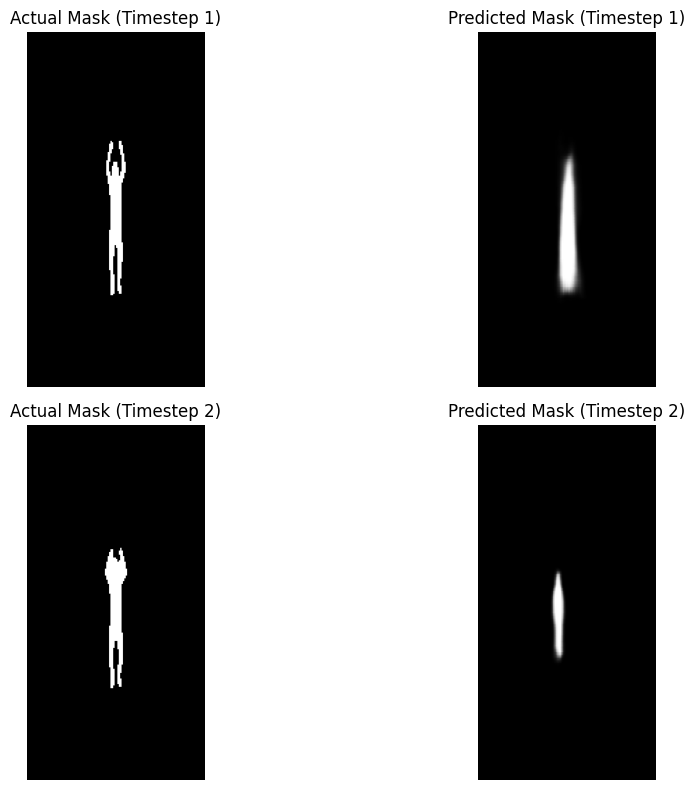

In [ ]:
# After training, perform inference on the validation set
model.eval()  # Set the model to evaluation mode

# Select a batch from the validation set for visualization
val_batch = next(iter(val_loader))  # Get one batch from the validation DataLoader
inputs, targets = val_batch  # inputs shape: (batch_size, 2, 256, 128), targets shape: (batch_size, 2, 256, 128)

# Perform inference on the selected batch
with torch.no_grad():  # Disable gradient calculation for inference
    predictions = model(inputs)  # Shape: (batch_size, 2, 1, 256, 128)

# Convert predictions and targets to NumPy arrays
predictions = predictions.cpu().numpy()  # Shape: (batch_size, 2, 1, 256, 128)
targets = targets.cpu().numpy()  # Shape: (batch_size, 2, 256, 128)

# Select an instance from the batch for visualization
instance_index = 0  # Change this to select a different instance
actual_mask = targets[instance_index]  # Shape: (2, 256, 128)
# predicted_mask = predictions[instance_index].squeeze(2)  # Remove singleton dimension: (2, 256, 128)

# Plot the actual and predicted masks
fig, axes = plt.subplots(2, 2, figsize=(12, 8))

# Plot actual mask for timestep 1
axes[0, 0].imshow(actual_mask[0][0], cmap="gray")
axes[0, 0].set_title("Actual Mask (Timestep 1)")
axes[0, 0].axis("off")

# Plot predicted mask for timestep 1
axes[0, 1].imshow(predictions[0][0][0], cmap="gray")
axes[0, 1].set_title("Predicted Mask (Timestep 1)")
axes[0, 1].axis("off")

# Plot actual mask for timestep 2
axes[1, 0].imshow(actual_mask[1][0], cmap="gray")
axes[1, 0].set_title("Actual Mask (Timestep 2)")
axes[1, 0].axis("off")

# Plot predicted mask for timestep 2
axes[1, 1].imshow(predictions[1][0][0], cmap="gray")
axes[1, 1].set_title("Predicted Mask (Timestep 2)")
axes[1, 1].axis("off")

plt.tight_layout()
plt.show()

In [ ]:
# Select an instance from the batch for visualization
instance_index = 0  # Change this to select a different instance
actual_mask = targets[instance_index]  # Shape: (2, 256, 128)

# Check the shape of predictions for the selected instance
predicted_mask = predictions[instance_index]  # Shape: (2, 1, 256, 128)

# Remove the singleton dimension if it exists
if predicted_mask.shape[1] == 1:
    predicted_mask = predicted_mask.squeeze(1)  # Shape: (2, 256, 128)
else:
    predicted_mask = predicted_mask  # Shape: (2, 256, 128)

# Plot the actual and predicted masks
fig, axes = plt.subplots(2, 2, figsize=(12, 12))

# Plot actual mask for timestep 1
axes[0, 0].imshow(actual_mask[0][0], cmap="gray")
axes[0, 0].set_title("Actual Mask (Timestep 1)")
axes[0, 0].axis("off")

# Plot predicted mask for timestep 1
axes[0, 1].imshow(predicted_mask[0], cmap="gray")
axes[0, 1].set_title("Predicted Mask (Timestep 1)")
axes[0, 1].axis("off")

# Plot actual mask for timestep 2
axes[1, 0].imshow(actual_mask[1][0], cmap="gray")
axes[1, 0].set_title("Actual Mask (Timestep 2)")
axes[1, 0].axis("off")

# Plot predicted mask for timestep 2
axes[1, 1].imshow(predicted_mask[1], cmap="gray")
axes[1, 1].set_title("Predicted Mask (Timestep 2)")
axes[1, 1].axis("off")

plt.tight_layout()
plt.show()

In [ ]:
import numpy as np

def compute_iou(actual_mask, predicted_mask):
    """
    Compute the Intersection over Union (IoU) between the actual and predicted masks.

    Parameters:
    actual_mask (numpy.ndarray): Ground truth mask of shape (2, 256, 128).
    predicted_mask (numpy.ndarray): Predicted mask of shape (2, 256, 128).

    Returns:
    float: The average IoU across both timesteps.
    """

    predicted_mask = (predicted_mask > 0.3).astype(np.uint8)  # Threshold at 0.5

    # Compute intersection and union
    intersection = np.logical_and(actual_mask, predicted_mask).sum(axis=(1, 2))  # Sum over spatial dimensions
    union = np.logical_or(actual_mask, predicted_mask).sum(axis=(1, 2))  # Sum over spatial dimensions

    # Compute IoU for each timestep
    iou_per_timestep = intersection / (union + 1e-6)  # Add epsilon to prevent division by zero

    # Return average IoU over timesteps
    return np.mean(iou_per_timestep)

# Compute IoU for the selected instance
iou = compute_iou(actual_mask, predictions)
print(f"Intersection over Union (IoU): {iou:.4f}")


Intersection over Union (IoU): 0.0059


In [ ]:
thresholds = [0.1, 0.3, 0.5, 0.7]


for threshold in thresholds:

    binarizedMask = (predicted_mask > threshold).astype(np.uint8)


    iou = compute_iou(actual_mask, binarizedMask) * 100


    print(f"IoU at threshold {threshold}: {iou:.4f}%")


## Unet

In [ ]:
# import torch
# import torch.nn as nn

# class UNet(nn.Module):
#     def __init__(self, in_channels=2, out_channels=1, init_features=32):
#         super(UNet, self).__init__()

#         features = init_features
#         self.encoder1 = UNet._block(in_channels, features, name="enc1")
#         self.pool1 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder2 = UNet._block(features, features * 2, name="enc2")
#         self.pool2 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder3 = UNet._block(features * 2, features * 4, name="enc3")
#         self.pool3 = nn.MaxPool2d(kernel_size=2, stride=2)
#         self.encoder4 = UNet._block(features * 4, features * 8, name="enc4")
#         self.pool4 = nn.MaxPool2d(kernel_size=2, stride=2)

#         self.bottleneck = UNet._block(features * 8, features * 16, name="bottleneck")

#         self.upconv4 = nn.ConvTranspose2d(
#             features * 16, features * 8, kernel_size=2, stride=2
#         )
#         self.decoder4 = UNet._block((features * 8) * 2, features * 8, name="dec4")
#         self.upconv3 = nn.ConvTranspose2d(
#             features * 8, features * 4, kernel_size=2, stride=2
#         )
#         self.decoder3 = UNet._block((features * 4) * 2, features * 4, name="dec3")
#         self.upconv2 = nn.ConvTranspose2d(
#             features * 4, features * 2, kernel_size=2, stride=2
#         )
#         self.decoder2 = UNet._block((features * 2) * 2, features * 2, name="dec2")
#         self.upconv1 = nn.ConvTranspose2d(
#             features * 2, features, kernel_size=2, stride=2
#         )
#         self.decoder1 = UNet._block(features * 2, features, name="dec1")

#         self.conv = nn.Conv2d(
#             in_channels=features, out_channels=out_channels, kernel_size=1
#         )

#     def forward(self, x):
#         enc1 = self.encoder1(x)
#         enc2 = self.encoder2(self.pool1(enc1))
#         enc3 = self.encoder3(self.pool2(enc2))
#         enc4 = self.encoder4(self.pool3(enc3))

#         bottleneck = self.bottleneck(self.pool4(enc4))

#         dec4 = self.upconv4(bottleneck)
#         dec4 = torch.cat((dec4, enc4), dim=1)
#         dec4 = self.decoder4(dec4)

#         dec3 = self.upconv3(dec4)
#         dec3 = torch.cat((dec3, enc3), dim=1)
#         dec3 = self.decoder3(dec3)

#         dec2 = self.upconv2(dec3)
#         dec2 = torch.cat((dec2, enc2), dim=1)
#         dec2 = self.decoder2(dec2)

#         dec1 = self.upconv1(dec2)
#         dec1 = torch.cat((dec1, enc1), dim=1)
#         dec1 = self.decoder1(dec1)

#         return torch.sigmoid(self.conv(dec1))

#     @staticmethod
#     def _block(in_channels, features, name):
#         return nn.Sequential(
#             nn.Conv2d(
#                 in_channels=in_channels,
#                 out_channels=features,
#                 kernel_size=3,
#                 padding=1,
#                 bias=False,
#             ),
#             nn.BatchNorm2d(num_features=features),
#             nn.ReLU(inplace=True),
#             nn.Conv2d(
#                 in_channels=features,
#                 out_channels=features,
#                 kernel_size=3,
#                 padding=1,
#                 bias=False,
#             ),
#             nn.BatchNorm2d(num_features=features),
#             nn.ReLU(inplace=True),
#         )

In [ ]:
# import torch
# import torch.nn as nn
# import torch.optim as optim

# class MaskRegressor(nn.Module):
#     def __init__(self):
#         super(MaskRegressor, self).__init__()

#         # Encoder
#         self.encoder = nn.Sequential(
#             nn.Conv2d(2, 32, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0),

#             nn.Conv2d(32, 64, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0),

#             nn.Conv2d(64, 128, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.MaxPool2d(kernel_size=2, stride=2, padding=0)
#         )

#         # Decoder
#         self.decoder = nn.Sequential(
#             nn.ConvTranspose2d(128, 64, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.Upsample(scale_factor=2, mode='nearest'),

#             nn.ConvTranspose2d(64, 32, kernel_size=3, stride=1, padding=1),
#             nn.ReLU(),
#             nn.Upsample(scale_factor=2, mode='nearest'),

#             nn.ConvTranspose2d(32, 1, kernel_size=3, stride=1, padding=1),
#             nn.Sigmoid(),  # Use Sigmoid to ensure the output is in range [0, 1]
#             nn.Upsample(scale_factor=2, mode='nearest')
#         )

#     def forward(self, x):
#         x = self.encoder(x)
#         x = self.decoder(x)
#         return x


In [ ]:
# import torch
# from torchsummary import summary

# # Set the device (GPU if available, otherwise CPU)
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# # Initialize the model and move it to the correct device
# # model = MaskRegressor().to(device)
# model = MaskRegressor.to(device)
# # Create a sample input tensor and move it to the same device
# input_tensor = torch.randn(1, 2, 256, 128).to(device)  # Batch size of 1, 2 channels

# # Print the summary for the model
# summary(model, input_size=(2, 256, 128))


In [ ]:
## Converting NumPy arrays to PyTorch tensors
XXHoriNorm = torch.from_numpy(XXHoriNorm).to(dtype=torch.float16).unsqueeze(1)  # (N, 1, 256, 128)
XXVertNorm = torch.from_numpy(XXVertNorm).to(dtype=torch.float16).unsqueeze(1)  # (N, 1, 256, 128)

## Converting masks to tensors
YY = torch.stack([torch.from_numpy(mask).to(dtype=torch.float16) for mask in YY['scaledMask']]).unsqueeze(1)  # (N, 1, 256, 128)

## Stacking heatmaps into a 2-channel input
X = torch.cat((XXHoriNorm, XXVertNorm), dim=1)  # Shape: (N, 2, 256, 128)

# Print memory-efficient tensor shapes
print(f"X shape: {X.shape}, dtype: {X.dtype}, memory: {X.element_size() * X.numel() / (1024**2):.2f} MB")
print(f"YY shape: {YY.shape}, dtype: {YY.dtype}, memory: {YY.element_size() * YY.numel() / (1024**2):.2f} MB")


In [ ]:
from torch.utils.data import TensorDataset, random_split

# Create a dataset
dataset = TensorDataset(X, YY)

# Define split sizes (80% train, 20% test)
train_size = int(0.8 * len(dataset))
test_size = len(dataset) - train_size

# Perform the split (random but preserving order)
train_dataset, test_dataset = random_split(dataset, [train_size, test_size])

# Extract train and test tensors
X_train, YY_train = zip(*train_dataset)
X_test, YY_test = zip(*test_dataset)

# Convert back to tensors
X_train = torch.stack(X_train)  # (N_train, 2, 256, 128)
YY_train = torch.stack(YY_train)  # (N_train, 1, 256, 128)

X_test = torch.stack(X_test)  # (N_test, 2, 256, 128)
YY_test = torch.stack(YY_test)  # (N_test, 1, 256, 128)

print(f"Train set: {X_train.shape}, {YY_train.shape}")
print(f"Test set: {X_test.shape}, {YY_test.shape}")


In [ ]:
import torch
print("GPU Available:", torch.cuda.is_available())
print("Device Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "CPU")


In [ ]:
from torch.utils.data import DataLoader, TensorDataset
import torch.optim as optim
import torch.nn as nn


## Hyperparameters to be tuned
batch_size = 64
epochs = 22
learning_rate = 1e-5




train_losses = []
test_losses = []


X_train = X_train.squeeze(dim=1).float()  ## removing the dimensions at
X_test = X_test.squeeze(dim=1).float()    ## index 1 to match with train data


# YY_train = YY_train.squeeze(dim=1).float()  ## removing the dimensions at
# YY_test = YY_test.squeeze(dim=1).float()    ## index 1 to match with train data

## Creating DataLoaders for training and testing
train_loader = DataLoader(TensorDataset(X_train, YY_train), batch_size=batch_size, shuffle=True)
test_loader = DataLoader(TensorDataset(X_test, YY_test), batch_size=batch_size, shuffle=False)

## Model
mask_regressor = MaskRegressor()

## Defining optimizer and loss function
optimizer = optim.Adam(mask_regressor.parameters(), lr=learning_rate)
criterion = nn.BCEWithLogitsLoss()


## Moving model to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
mask_regressor.to(device)

## Training loop
for epoch in range(epochs):
    mask_regressor.train()
    total_loss = 0

    for X_batch, YY_batch in train_loader:
        X_batch, YY_batch = X_batch.to(device), YY_batch.to(device)

        optimizer.zero_grad()


        predicted_mask = mask_regressor(X_batch)


        loss = criterion(predicted_mask, YY_batch)


        loss.backward()
        optimizer.step()

        total_loss += loss.item()

    avg_train_loss = total_loss / len(train_loader)
    train_losses.append(avg_train_loss)


    mask_regressor.eval()
    with torch.no_grad():
        total_test_loss = 0
        for X_batch, YY_batch in test_loader:
            X_batch, YY_batch = X_batch.to(device), YY_batch.to(device)

            predicted_mask = mask_regressor(X_batch)
            loss = criterion(predicted_mask, YY_batch)
            total_test_loss += loss.item()

    avg_test_loss = total_test_loss / len(test_loader)
    test_losses.append(avg_test_loss)

    print(f"Epoch [{epoch+1}/{epochs}], Train Loss: {avg_train_loss:.4f}, Test Loss: {avg_test_loss:.4f}")


In [ ]:
predicted_mask.shape

In [ ]:
import matplotlib.pyplot as plt

def plotLosses(train_losses, test_losses):
    epochs = range(1, len(train_losses) + 1)
    plt.figure(figsize=(10, 6))
    plt.plot(epochs, train_losses, label='Training Loss', color='blue', marker='o')
    plt.plot(epochs, test_losses, label='Test Loss', color='red', marker='x')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.title('Training and Test Loss Over Epochs')
    plt.legend()
    plt.grid(True)
    plt.show()

In [ ]:
plotLosses(train_losses, test_losses)


**RF-Mask**

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:38:22
 # @ Description: Additional useful definition.
 '''

import numpy as np
import torch
import torch.nn.functional as F
from torchvision.models.detection.transform import GeneralizedRCNNTransform
from torchvision.ops import boxes as box_ops
from torchvision.ops import roi_align
from torchvision.ops.boxes import box_area

from ..datasets import camera_parameter


class RFTransform(GeneralizedRCNNTransform):
    """Data transformation. Normalize input data."""

    def __init__(self, min_size, max_size):
        super(RFTransform, self).__init__(min_size, max_size, [0] * 6, [1] * 6)

    def normalize(self, image):
        if not image.is_floating_point():
            raise TypeError(
                f"Expected input images to be of floating type (in range [0, 1]), "
                f"but found type {image.dtype} instead"
            )
        std, mean = torch.std_mean(image, dim=(1, 2), unbiased=True)
        return (image - mean[:, None, None]) / std[:, None, None]

def box_iou(boxes1, boxes2, eps=1e-7):
    """Calucate ious between two bunch of boxes.

    Args:
        boxes1 (tensor): First bunch of boxes.
        boxes2 (tensor): Second bunch of boxes.
        eps (float, optional): Avoid zero divide. Defaults to 1e-7.

    Returns:
        _type_: _description_
    """
    area1 = box_area(boxes1)
    area2 = box_area(boxes2)

    lt = torch.max(boxes1[:, None, :2], boxes2[:, :2])  # [N,M,2]
    rb = torch.min(boxes1[:, None, 2:], boxes2[:, 2:])  # [N,M,2]
    wh = (rb - lt).clamp(min=0)  # [N,M,2]
    inter = wh[:, :, 0] * wh[:, :, 1]  # [N,M]

    union = area1[:, None] + area2 - inter

    iou = inter / (union + eps)
    return iou, union

def _onnx_paste_mask_in_image(mask, box, im_h, im_w):
    """Copied from torchvision.models.detection.roi_heads"""

    one = torch.ones(1, dtype=torch.int64)
    zero = torch.zeros(1, dtype=torch.int64)

    w = (box[2] - box[0] + one)
    h = (box[3] - box[1] + one)
    w = torch.max(torch.cat((w, one)))
    h = torch.max(torch.cat((h, one)))

    # Set shape to [batchxCxHxW]
    mask = mask.expand((1, 1, mask.size(0), mask.size(1)))

    # Resize mask
    mask = F.interpolate(mask, size=(int(h), int(w)), mode='bilinear', align_corners=False)
    mask = mask[0][0]

    x_0 = torch.max(torch.cat((box[0].unsqueeze(0), zero)))
    x_1 = torch.min(torch.cat((box[2].unsqueeze(0) + one, im_w.unsqueeze(0))))
    y_0 = torch.max(torch.cat((box[1].unsqueeze(0), zero)))
    y_1 = torch.min(torch.cat((box[3].unsqueeze(0) + one, im_h.unsqueeze(0))))

    unpaded_im_mask = mask[(y_0 - box[1]):(y_1 - box[1]),
                           (x_0 - box[0]):(x_1 - box[0])]

    # TODO : replace below with a dynamic padding when support is added in ONNX

    # pad y
    zeros_y0 = torch.zeros(y_0, unpaded_im_mask.size(1))
    zeros_y1 = torch.zeros(im_h - y_1, unpaded_im_mask.size(1))
    concat_0 = torch.cat((zeros_y0,
                          unpaded_im_mask.to(dtype=torch.float32),
                          zeros_y1), 0)[0:im_h, :]
    # pad x
    zeros_x0 = torch.zeros(concat_0.size(0), x_0)
    zeros_x1 = torch.zeros(concat_0.size(0), im_w - x_1)
    im_mask = torch.cat((zeros_x0,
                         concat_0,
                         zeros_x1), 1)[:, :im_w]
    return im_mask

@torch.jit._script_if_tracing
def _onnx_paste_masks_in_image_loop(masks, boxes, im_h, im_w):
    """Copied from torchvision.models.detection.roi_heads"""

    res_append = torch.zeros(0, im_h, im_w)
    for i in range(masks.size(0)):
        mask_res = _onnx_paste_mask_in_image(masks[i][0], boxes[i], im_h, im_w)
        mask_res = mask_res.unsqueeze(0)
        res_append = torch.cat((res_append, mask_res))
    return res_append

def project_3d_to_pixel(points, M, P, D, K):
    """Project 3D points into result image plane.

    Args:
        points (tensor): 3D points obtained in input radar coordinate.
        M (tensor): Camera paramter.
        P (tensor): Camera paramter.
        D (tensor): Camera paramter.
        K (tensor): Camera paramter.

    Returns:
        pts (tensor): Projected 2D points in result image plane.
    """

    pts = torch.ones((1, points.shape[0]), device=points.device)
    pts = torch.cat([points.t(), pts], dim=0)
    cc = torch.mm(M, pts)
    pc = (cc[:2] / cc[2]).t()
    fx, fy, cx, cy, Tx, Ty = P[0,0], P[1,1], P[0,2], P[1,2], P[0,3], P[1,3]
    uv_rect_x, uv_rect_y = pc[:, 0], pc[:, 1]
    xp, yp = (uv_rect_x - cx - Tx) / fx, (uv_rect_y - cy - Ty) / fy
    r2 = xp * xp + yp * yp
    r4 = r2 * r2
    r6 = r4 * r2
    a1 = 2 * xp * yp
    k1, k2, p1, p2, k3 = D
    barrel = 1 + k1 * r2 + k2 * r4 + k3 * r6
    xpp = xp * barrel + p1 * a1 + p2 * (r2 + 2 * (xp * xp))
    ypp = yp * barrel + p1 * (r2 + 2 * (yp * yp)) + p2 * a1
    kfx, kcx, kfy, kcy = K[0, 0], K[0, 2], K[1, 1], K[1, 2]
    u = xpp * kfx + kcx
    v = ypp * kfy + kcy
    pts = torch.stack([u, v], dim=0).t()
    pts = pts / 2
    return pts

def calc_v_props(h_proposals, params, project=True, pad=25):
    """Calculate vertical proposals according to horizontal proposals.

    Args:
        h_proposals (list): Horizontal proposals.
        params (tensor): View (environment) index.
        project (bool, optional): If true, projected results will be returned, else only returns vertical proposals. Defaults to True.
        pad (int, optional): Paddings added into projected boxes. Defaults to 25.

    Returns:
        v_props (list): Vertical proposals.
        proposals (list): Projected results.
    """
    v_props = []
    for prop, param in zip(h_proposals, params):
        param = camera_parameter[f'view{param.int().item():02d}']
        for key, value in param.items():
            param[key] = value
        x_off, y_off, z_off, r_off, z_min, z_max = param['offset']
        v = prop.clone()
        for i in [1, 3]:
            _ = (160 - prop[:, i]) ** 2 + (prop[:, 0]/2 + prop[:, 2]/2 - r_off) ** 2
            v[:, i] = 160 - _ ** 0.5
        v[:, 0] = z_min
        v[:, 2] = z_max
        v_props.append(v)
    if not project:
        return v_props

    proposals = []
    for h, v, param in zip(h_proposals, v_props, params):
        param = camera_parameter[f'view{param.cpu().int().item():02d}']
        for key, value in param.items():
            param[key] = torch.from_numpy(np.array(value)).to(device=h.device, dtype=h.dtype) if isinstance(value, list) else value
        x_off, y_off, z_off, r_off, z_min, z_max = param['offset']
        r_mat = param['r_mat']
        M, P, D, K = param['M'], param['P'], param['D'], param['K']

        if h.numel() == 0:
            proposals.append(torch.zeros((1, 4), device=h.device))
            continue
        co = torch.zeros((h.size(0), 6), device=h.device)

        co[:, [0, 1]] = (h[:, [0, 2]] - x_off) * 0.05
        co[:, [2, 3]] = (y_off - h[:, [1, 3]]) * 0.05
        co[:, [4, 5]] = (z_off - v[:, [0, 2]]) * 0.05

        _ = [0,2,4,0,2,5,0,3,4,0,3,5,1,2,4,1,2,5,1,3,4,1,3,5]
        coor3d = co[:, _]
        coor3d = coor3d.view(-1, 3)
        coor3d = torch.mm(coor3d, r_mat.t())

        # Project 3D points into result image plane.
        coor2d = project_3d_to_pixel(coor3d, M, P, D, K)
        coor2d = coor2d.view(-1, 8, 2)

        xymin = torch.min(coor2d, dim=1)[0] - pad
        xymax = torch.max(coor2d, dim=1)[0] + pad
        coor2d = torch.cat([xymin, xymax], dim=1)
        proposals.append(coor2d)

    return v_props, proposals


def project_masks_on_boxes(gt_masks, boxes, matched_idxs, M):
    """
    Given segmentation masks and the bounding boxes corresponding
    to the location of the masks in the image, this function
    crops and resizes the masks in the position defined by the
    boxes. This prepares the masks for them to be fed to the
    loss computation as the targets.
    """
    matched_idxs = matched_idxs.to(boxes)
    rois = torch.cat([matched_idxs[:, None], boxes], dim=1)
    gt_masks = gt_masks[:, None].to(rois)
    return roi_align(gt_masks, rois, (M, M), 1.0)[:, 0]

def maskrcnn_loss(mask_logits, proposals, gt_masks, gt_labels, mask_matched_idxs):
    """
    Args:
        proposals (list[BoxList])
        mask_logits (Tensor)
        targets (list[BoxList])

    Return:
        mask_loss (Tensor): scalar tensor containing the loss
    """

    discretization_size = mask_logits.shape[-1]
    labels = [gt_label[idxs] for gt_label, idxs in zip(gt_labels, mask_matched_idxs)]
    mask_targets = [
        project_masks_on_boxes(m, p, i, discretization_size) for m, p, i in zip(gt_masks, proposals, mask_matched_idxs)
    ]

    labels = torch.cat(labels, dim=0)
    mask_targets = torch.cat(mask_targets, dim=0)

    # torch.mean (in binary_cross_entropy_with_logits) doesn't
    # accept empty tensors, so handle it separately
    if mask_targets.numel() == 0:
        return mask_logits.sum() * 0

    mask_loss = F.binary_cross_entropy_with_logits(
        mask_logits[torch.arange(labels.shape[0], device=labels.device), labels], mask_targets
    )
    return mask_loss

def iou(mask1, mask2):
    inter = torch.logical_and(mask1, mask2)
    union = torch.logical_or(mask1, mask2)
    return torch.sum(inter.flatten(1), dim=1) / torch.sum(union.flatten(1), dim=1)

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 2022-07-14 20:16:32
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-07-14 20:17:41
 # @ Description: RF Region proposal network
 '''

from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection.rpn import (RegionProposalNetwork, RPNHead,
                                              concat_box_prediction_layers)


class RFRPN(RegionProposalNetwork):
    """Region Proposal Network definition which is copied from torchvision."""

    def __init__(self, out_channels=256):
        anchor_sizes = ((8, 16, 32, 64, 128),) * 5
        aspect_ratios = ((0.5, 1.0, 2.0),) * len(anchor_sizes)
        rpn_anchor_generator = AnchorGenerator(anchor_sizes, aspect_ratios)
        rpn_head = RPNHead(out_channels, rpn_anchor_generator.num_anchors_per_location()[0])
        rpn_pre_nms_top_n_train = 1000
        rpn_pre_nms_top_n_test = 500
        rpn_post_nms_top_n_train = 1000
        rpn_post_nms_top_n_test = 500
        rpn_nms_thresh = 0.7
        rpn_fg_iou_thresh = 0.7
        rpn_bg_iou_thresh = 0.3
        rpn_batch_size_per_image = 256
        rpn_positive_fraction = 0.5
        rpn_pre_nms_top_n = dict(training=rpn_pre_nms_top_n_train, testing=rpn_pre_nms_top_n_test)
        rpn_post_nms_top_n = dict(training=rpn_post_nms_top_n_train, testing=rpn_post_nms_top_n_test)
        super(RFRPN, self).__init__(
            rpn_anchor_generator, rpn_head,
            rpn_fg_iou_thresh, rpn_bg_iou_thresh,
            rpn_batch_size_per_image, rpn_positive_fraction,
            rpn_pre_nms_top_n, rpn_post_nms_top_n, rpn_nms_thresh)

    def forward(self, images, features, targets=None):
        # RPN uses all feature maps that are available
        features = list(features.values())
        objectness, pred_bbox_deltas = self.head(features)
        anchors = self.anchor_generator(images, features)

        num_images = len(anchors)
        num_anchors_per_level_shape_tensors = [o[0].shape for o in objectness]
        num_anchors_per_level = [s[0] * s[1] * s[2] for s in num_anchors_per_level_shape_tensors]
        objectness, pred_bbox_deltas = concat_box_prediction_layers(objectness, pred_bbox_deltas)
        # apply pred_bbox_deltas to anchors to obtain the decoded proposals
        # note that we detach the deltas because Faster R-CNN do not backprop through
        # the proposals
        proposals = self.box_coder.decode(pred_bbox_deltas.detach(), anchors)
        proposals = proposals.view(num_images, -1, 4)
        boxes, scores = self.filter_proposals(proposals, objectness, images.image_sizes, num_anchors_per_level)

        losses = {}
        if targets is not None:
            labels, matched_gt_boxes = self.assign_targets_to_anchors(anchors, targets)
            regression_targets = self.box_coder.encode(matched_gt_boxes, anchors)
            loss_objectness, loss_rpn_box_reg = self.compute_loss(
                objectness, pred_bbox_deltas, labels, regression_targets)
            losses = {
                "loss_objectness": loss_objectness,
                "loss_rpn_box_reg": loss_rpn_box_reg,
            }
        return boxes, losses

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:04:30
 # @ Description: RFMask backbone definition
 '''

from torchvision.models.detection.backbone_utils import BackboneWithFPN, resnet
from torchvision.ops import misc as misc_nn_ops
from torchvision.ops.feature_pyramid_network import LastLevelMaxPool


def resnet_fpn_backbone(
    backbone_name,
    pretrained,
    norm_layer=misc_nn_ops.FrozenBatchNorm2d,
    trainable_layers=3,
    returned_layers=None,
    extra_blocks=None
):
    backbone = resnet.__dict__[backbone_name](
        pretrained=pretrained,
        norm_layer=norm_layer)

    # select layers that wont be frozen
    assert 0 <= trainable_layers <= 5
    layers_to_train = ['layer4', 'layer3', 'layer2', 'layer1', 'conv1'][:trainable_layers]
    if trainable_layers == 5:
        layers_to_train.append('bn1')
    for name, parameter in backbone.named_parameters():
        if all([not name.startswith(layer) for layer in layers_to_train]):
            parameter.requires_grad_(False)

    if extra_blocks is None:
        extra_blocks = LastLevelMaxPool()

    if returned_layers is None:
        returned_layers = [1, 2, 3, 4]
    assert min(returned_layers) > 0 and max(returned_layers) < 5
    return_layers = {f'layer{k}': str(v) for v, k in enumerate(returned_layers)}

    in_channels_stage2 = backbone.inplanes // 8
    in_channels_list = [in_channels_stage2 * 2 ** (i - 1) for i in returned_layers]
    out_channels = 64
    return BackboneWithFPN(backbone, return_layers, in_channels_list, out_channels, extra_blocks=extra_blocks)

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:13:24
 # @ Description: Branch definition, containing Encoder module.
 '''

from collections import OrderedDict
from turtle import forward

import torch.nn as nn
from torchvision.models.detection.anchor_utils import AnchorGenerator
from torchvision.models.detection.rpn import RegionProposalNetwork, RPNHead

from .backbone import misc_nn_ops, resnet_fpn_backbone
from .rpn import RFRPN
from .utils import RFTransform


class Encoder(nn.Module):
    """Backbone feature extractor. We tried two kinds of backbone structures.
       Eight convolution layers or resnet18. In the end, we choose to use 'resnet18'.
    """

    def __init__(self, in_channels=6, min_size=160, max_size=200):
        """
        Backbone feature constructor.

        Args:
            in_channels (int, optional): Channel number of input data. Defaults to 6.
            backbone (str, optional): Which backbone to use, candidate values are ['convs', 'resnet18']. Defaults to 'resnet'.
            min_size (int, optional): Height of input data. Defaults to 160.
            max_size (int, optional): Width of input data. Defaults to 200.
        """
        nn.Module.__init__(self)
        backbone = 'resnet18'
        self.backbone = backbone
        assert backbone in ['convs', 'resnet18'], \
            f'backbone should be one of ["convs", "resnet18"], but get {backbone} instead.'
        if backbone == 'convs':
            self.conv = nn.Sequential(
                nn.Conv2d(6, 1, kernel_size=1, stride=1, padding=0, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(1),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(1, 64, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(64),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(64, 128, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(128, 128, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(128),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(128, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True),
                nn.Conv2d(256, 256, kernel_size=5, stride=1, padding=2, padding_mode='replicate', bias=False),
                nn.BatchNorm2d(256),
                nn.LeakyReLU(inplace=True)
            )
            self.out_channels = 256
        elif backbone == 'resnet18':
            self.conv = resnet_fpn_backbone('resnet18', pretrained=False,
                                            trainable_layers=5, norm_layer=nn.BatchNorm2d)
            self.conv.body.conv1 = nn.Conv2d(12, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
            self.out_channels = self.conv.out_channels
        self.transform = RFTransform(min_size, max_size)

    def forward(self, x, target=None):
        # Transform input data according to 'min_size' and 'max_size'
        x, target = self.transform(x, target)
        features = self.conv(x.tensors)
        # Uniform return value format
        if self.backbone == 'convs':
            return OrderedDict([('0', features)]), x, target
        return features, x, target

class Branch(nn.Module):
    """Branch model definition.
       Branch is responsible for extract feature and perform RPN
    """

    def __init__(self, backbone):
        """
        Branch model constructor.

        Args:
            backbone (Encoder): Encoder class instance.
        """
        nn.Module.__init__(self)
        self.backbone = backbone
        self.out_channels = backbone.out_channels
        self.rpn = RFRPN(self.out_channels)

    def forward(self, images, targets=None):
        # Extract features and perform RPN.
        features, images, targets = self.backbone(images, targets)
        proposals, proposal_losses = self.rpn(images, features, targets)
        return features, proposals, proposal_losses, images, targets

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:16:21
 # @ Description: Predictor definition.
 '''

from collections import OrderedDict

import torch.nn as nn


class RFMaskRCNNPredictor(nn.Sequential):
    def __init__(self, in_channels, dim_reduced, num_classes):
        super(RFMaskRCNNPredictor, self).__init__(OrderedDict([
            ("conv5_mask", nn.ConvTranspose2d(in_channels, dim_reduced, 2, 2, 0)),
            ("relu5", nn.ReLU(inplace=True)),
            ("conv6_mask", nn.ConvTranspose2d(dim_reduced, dim_reduced // 2, 2, 2, 0)),
            ("relu6", nn.ReLU(inplace=True)),
            ("conv7_mask", nn.ConvTranspose2d(dim_reduced // 2, dim_reduced // 4, 2, 2, 0)),
            ("relu7", nn.ReLU(inplace=True)),
            ("mask_fcn_logits", nn.Conv2d(dim_reduced // 4, num_classes, 1, 1, 0)),
        ]))

        for name, param in self.named_parameters():
            if "weight" in name:
                nn.init.kaiming_normal_(param, mode="fan_out", nonlinearity="relu")

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-08-27 13:39:35
 # @ Description: RFMask main structure definition.
 '''

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
from torch import Tensor
from torch.jit.annotations import Dict, List, Optional, Tuple
from torchvision.models.detection.roi_heads import expand_boxes, expand_masks

from .branch import Branch, Encoder
from .roi_heads import RFRoIHeads
from .utils import _onnx_paste_masks_in_image_loop


class RFMask(nn.Module):
    """RFMask model definition."""

    def __init__(self, dual=True, fuse='multi-head'):
        """RFMask model constructor.

        Args:
            num_classes (int, optional): Number of categories to classifiy. Defaults to 2.
            dual (bool, optional): Dual-branch version of RFMask or single-branch version of RFMask.
            fuse (str, optional): Choose feature fuse method in dual-branch version of RFMask,
                                        fuse with proposed multi-head attention or simple concatenation.
        """
        nn.Module.__init__(self)
        # Horizontal and vertical branches have the same structure.
        self.hbranch = Branch(Encoder())
        self.vbranch = Branch(Encoder()) if dual else None
        self.num_classes = 2
        self.dual = dual
        self.mask_size = (624, 820) # (1248, 1640)
        self.roi_heads = RFRoIHeads(self.hbranch.out_channels, dual=dual, fuse=fuse)

    def prepare_targets(self, targets, key='hboxes'):
        """Reorganize label structure.

        Args:
            targets (dict): Containing box and silhouette labels.
            key (str, optional): Assign the value of targets[key] to targets['boxes']. Defaults to 'hboxes'.

        Returns:
            dict: Reorganized dict.
        """
        if targets is None:
            return targets
        for target in targets:
            target['boxes'] = target[key]
        return targets

    def paste_mask_in_image(self, mask, box, im_h, im_w):
        # type: (Tensor, Tensor, int, int) -> Tensor
        TO_REMOVE = 1
        w = int(box[2] - box[0] + TO_REMOVE)
        h = int(box[3] - box[1] + TO_REMOVE)
        #w = max(w, 1)
        #h = max(h, 1)
        if w > 2 * im_w or h > 2 * im_h:
            return torch.zeros((im_h, im_w), dtype=mask.dtype, device=mask.device)

        w = max(w, 1) if w < im_w else im_w
        h = max(h, 1) if h < im_h else im_h

        # Set shape to [batchxCxHxW]
        mask = mask.expand((1, 1, -1, -1))

        # Resize mask
        mask = F.interpolate(mask, size=(h, w), mode='bilinear', align_corners=False)
        mask = mask[0][0]

        im_mask = torch.zeros((im_h, im_w), dtype=mask.dtype, device=mask.device)
        x_0 = max(box[0], 0)
        x_1 = min(box[2] + 1, im_w)
        y_0 = max(box[1], 0)
        y_1 = min(box[3] + 1, im_h)
        _ = mask[
            (y_0 - box[1]):(y_1 - box[1]), (x_0 - box[0]):(x_1 - box[0])
        ]
        if im_mask[y_0:y_1, x_0:x_1].numel() == _.numel():
            im_mask[y_0:y_1, x_0:x_1] = _
        return im_mask

    def paste_masks_in_image(self, masks, boxes, img_shape, padding=1):
        # type: (Tensor, Tensor, Tuple[int, int], int) -> Tensor
        masks, scale = expand_masks(masks, padding=padding)
        boxes = expand_boxes(boxes, scale).to(dtype=torch.int64)
        im_h, im_w = img_shape

        if torchvision._is_tracing():
            return _onnx_paste_masks_in_image_loop(masks, boxes,
                                                   torch.scalar_tensor(im_h, dtype=torch.int64),
                                                   torch.scalar_tensor(im_w, dtype=torch.int64))[:, None]
        res = [
            self.paste_mask_in_image(m[0], b, im_h, im_w)
            for m, b in zip(masks, boxes)
        ]
        if len(res) > 0:
            ret = torch.stack(res, dim=0)[:, None]
        else:
            ret = masks.new_empty((0, 1, im_h, im_w))
        return ret

    def forward(self, hor, ver, params, targets=None):
        """Main inference function of RFMask model.

        Args:
            hor (FloatTensor): Horizontal RF frames.
            ver (FloatTensor): Vertical RF frames.
            params (IntTensor): View (Environment) index of each data in a batch which is used to load camera parameters.
            targets (dict, optional): Label dict. Defaults to None.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (dict): Losses
        """
        # We use the off-the-shelf RPN model implemented by torchvision official code
        # which could be found in torchvision.models.detection.rpn.
        # RPN in torchvision automatically loads 'boxes' key in label dict as ground-truth.

        targets = self.prepare_targets(targets, 'hboxes')
        h_features, h_proposals, h_prop_losses, hor, h_target = self.hbranch(hor, targets)
        # Pack rpn outputs into tuples and feed them into roi_heads
        h_bundle = (h_features, h_proposals, hor.image_sizes)

        if self.dual:
            targets = self.prepare_targets(targets, 'vboxes')
            v_features, v_proposals, v_prop_losses, ver, v_target = self.vbranch(ver, targets)
            # Pack rpn outputs into tuples and feed them into roi_heads
            v_bundle = (v_features, v_proposals, ver.image_sizes)
        else:
            v_bundle = None

        result, losses = self.roi_heads(h_bundle, v_bundle, params, targets)

        # # Calculate mask results
        # for i, pred in enumerate(result):
        #     masks = pred["masks"]
        #     boxes = pred['boxes']
        #     o_im_s = self.mask_size
        #     masks = self.paste_masks_in_image(masks, boxes, o_im_s)
        #     result[i]["masks"] = masks

        # If targets is passed then loss value will be returned, else losses is None.
        if not targets is None:
            rpn_loss = {}
            rpn_loss['loss_h_obj'] = h_prop_losses['loss_objectness']
            rpn_loss['loss_h_rpn_box'] = h_prop_losses['loss_rpn_box_reg']
            if self.dual:
                rpn_loss['loss_v_obj'] = v_prop_losses['loss_objectness']
                rpn_loss['loss_v_rpn_box'] = v_prop_losses['loss_rpn_box_reg']
            losses.update(rpn_loss)

            return result, losses
        else:
            for i, pred in enumerate(result):
                masks = pred["masks"]
                boxes = pred['boxes']
                o_im_s = self.mask_size
                masks = self.paste_masks_in_image(masks, boxes, o_im_s)
                result[i]["masks"] = masks
            return result, losses

In [ ]:
'''
 # @ Author: Zhi Wu
 # @ Create Time: 1970-01-01 00:00:00
 # @ Modified by: Zhi Wu
 # @ Modified time: 2022-11-23 08:50:51
 # @ Description: RoIHeads module definition.
 '''

import torch
import torch.nn as nn
from torch import Tensor
from torch.jit.annotations import Dict, List, Optional, Tuple
from torchvision.models.detection.faster_rcnn import (FastRCNNPredictor,
                                                      TwoMLPHead)
from torchvision.models.detection.mask_rcnn import MaskRCNNHeads
# from torchvision.models.detection.roi_heads import maskrcnn_loss, maskrcnn_inference
from torchvision.models.detection.roi_heads import (RoIHeads, fastrcnn_loss,
                                                    maskrcnn_inference)
from torchvision.ops import MultiScaleRoIAlign

from .predictor import RFMaskRCNNPredictor
from .utils import calc_v_props, maskrcnn_loss


class RFRoIHeads(RoIHeads):
    """RFRoIHeads is the core part of RFMask, it is responsible for regressing 2D detection
       results, calculating 3D bounding boxes, cropping roi features, fuse features and
       generate final results.

       RFRoIHeads is inherited from RoIHeads implemented by torchvision. Original codes can
       be found in torchvision.models.detection.roi_heads
    """
    def __init__(self, out_channels=256, dual=True, fuse='multi-head'):
        """RFRoIHeads constructor.

        Args:
            out_channels (int, optional): Feature channels outputed by Branch. Defaults to 256.
            fuse (str, optional): Feature fusion method, candicate method are ['multi-head0, 'cat'']. Defaults to multi-head fusion.
        """
        # Box regression parameters
        box_fg_iou_thresh, box_bg_iou_thresh = 0.5, 0.5
        box_batch_size_per_image, box_positive_fraction = 512, 0.25
        bbox_reg_weights = None
        box_score_thresh, box_nms_thresh, box_detections_per_img = 0.05, 0., 100

        # Build roiheads
        box_roi_pool = MultiScaleRoIAlign(
            featmap_names=['0'], output_size=14, sampling_ratio=2)
        box_head = TwoMLPHead(
            out_channels * box_roi_pool.output_size[0] ** 2, 1024)
        self.num_cls = 2
        box_predictor = FastRCNNPredictor(1024, self.num_cls)
        super(RFRoIHeads, self).__init__(
            box_roi_pool, box_head, box_predictor,
            box_fg_iou_thresh, box_bg_iou_thresh,
            box_batch_size_per_image, box_positive_fraction,
            bbox_reg_weights,
            box_score_thresh, box_nms_thresh, box_detections_per_img
        )

        self.vbox_head = TwoMLPHead(
            out_channels * box_roi_pool.output_size[0] ** 2, 1024)
        self.vbox_predictor = FastRCNNPredictor(1024, self.num_cls)
        self.compress = nn.Sequential(
            nn.Flatten(),
            nn.Linear(2 * 14 * 14, 2000),
            nn.LeakyReLU(inplace=True),
            nn.Linear(2000, 14 * 14),
        )
        self.mask_roi_pool = MultiScaleRoIAlign(
                featmap_names=['0'], output_size=14, sampling_ratio=2)

        # initialize fuse method
        assert fuse in ['multi-head', 'cat'], f'candidate fusion methods are ["multi-head", "cat"], but got {fuse}.'
        head_in_feature = 1 if dual else 64
        if dual and fuse == 'multi-head':
            head_in_feature = 1
            self.fuse = self.multi_head_fusion
        elif dual and fuse == 'cat':
            head_in_feature = 128
            self.fuse = self.concatenate_fusion
        else:
            head_in_feature = 64

        self.mask_head = MaskRCNNHeads(head_in_feature, (64,), 1)
        self.mask_predictor = RFMaskRCNNPredictor(64, 32, self.num_cls)
        # self.mask_size = (624, 820)

        self.trans = self.trans_enc(d_model=64*14, num_layers=3)
        self.multi_head = nn.MultiheadAttention(64*14, 8)

    def trans_enc(self, d_model, nheads=8, num_layers=2):
        """Build transformer encoder.

        Args:
            d_model (int): Set 'd_model' of transformer.
            nheads (int, optional): Number of transformer heads. Defaults to 8.
            num_layers (int, optional): Number of layers. Defaults to 2.

        Returns:
            dec (nn.Module): TransformerEncoder object.
        """
        encoder_layer = nn.TransformerEncoderLayer(d_model=d_model, nhead=nheads)
        enc = nn.TransformerEncoder(encoder_layer, num_layers=num_layers)
        return enc

    def trans_dec(self, d_model, nheads=8, num_layers=2):
        """Build transformer decoder.

        Args:
            d_model (int): Set 'd_model' of transformer.
            nheads (int, optional): Number of transformer heads. Defaults to 8.
            num_layers (int, optional): Number of layers. Defaults to 2.

        Returns:
            dec (nn.Module): TransformerDecoder object.
        """
        decoder_layer = nn.TransformerDecoderLayer(d_model=d_model, nhead=nheads)
        dec = nn.TransformerDecoder(decoder_layer, num_layers=num_layers)
        return dec

    def select_training_samples(self,
                                proposals,  # type: List[Tensor]
                                targets,     # type: Optional[List[Dict[str, Tensor]]]
                                key='boxes'
                                ):
        # type: (...) -> Tuple[List[Tensor], List[Tensor], List[Tensor], List[Tensor]]
        """This function is copied from torchvision.models.detection.roi_heads.

        Args:
            proposals (list): Proposals generated by RPN.
            targets (dict): Ground-truth labels.
            key (str): Indicating which key in targets contains ground-truth boxes.

        Returns:
            proposals (list): Selected proposals.
            matched_idxs (list): Indexes of selected proposals.
            labels (list): Labels of each selected input (with in a batch).
            regression_targets (tensor): Encoded box results for regressing.
            sampled_inds (list): Remove ignored samples indexes, retain positive/negtive samples indexes.
        """
        self.check_targets(targets)
        assert targets is not None
        dtype = proposals[0].dtype
        device = proposals[0].device

        gt_boxes = [t[key].to(dtype) for t in targets]
        gt_labels = [t["labels"] for t in targets]

        # append ground-truth bboxes to propos
        proposals = self.add_gt_proposals(proposals, gt_boxes)

        # get matching gt indices for each proposal
        matched_idxs, labels = self.assign_targets_to_proposals(proposals, gt_boxes, gt_labels)
        # sample a fixed proportion of positive-negative proposals
        sampled_inds = self.subsample(labels)
        matched_gt_boxes = []
        num_images = len(proposals)
        for img_id in range(num_images):
            img_sampled_inds = sampled_inds[img_id]
            proposals[img_id] = proposals[img_id][img_sampled_inds]
            labels[img_id] = labels[img_id][img_sampled_inds]
            matched_idxs[img_id] = matched_idxs[img_id][img_sampled_inds]

            gt_boxes_in_image = gt_boxes[img_id]
            if gt_boxes_in_image.numel() == 0:
                gt_boxes_in_image = torch.zeros((1, 4), dtype=dtype, device=device)
            matched_gt_boxes.append(gt_boxes_in_image[matched_idxs[img_id]])

        regression_targets = self.box_coder.encode(matched_gt_boxes, proposals)
        return proposals, matched_idxs, labels, regression_targets, sampled_inds

    def concatenate_fusion(self, h_feats, v_feats, pool_size=14):
        """Fuse feature by MLP.

        Args:
            h_feats (tensor): Horizontal roi features.
            v_feats (tensor): Vertical roi features.
            pool_size (int, optional): Pooled shape. Defaults to 14.
        """
        feats =  torch.cat([h_feats, v_feats], axis=-3)
        return feats
        b, c = h_feats.size()[:2]
        feats = torch.stack([h_feats, v_feats], dim=-3)
        feats = feats.view(-1, *feats.size()[-3:])
        feats = self.compress(feats)
        feats = feats.view(b, c, pool_size, pool_size)
        return feats

    def multi_head_fusion(self, h_feats, v_feats, pool_size=14):
        """Multi-Head fusion module.

        Args:
            h_feats (tensor): Horizontal RoI features. Shape [proposal_num, 64, 14, 14]
            v_feats (tensor): Vertical RoI features. Shape [proposal_num, 64, 14, 14]
            pool_size (int, optional): Pooled shape. Defaults to 14.

        Returns:
            att_weights (tensor): Attention weights calculcated by transformer.
        """
        n, c, h, w = h_feats.shape
        feats = torch.cat([h_feats, v_feats], dim=-1).view(n, c * h, 2 * w)
        feats = feats.permute(2, 0, 1)
        feats = self.trans(feats)
        att_output, att_weights = self.multi_head(feats, feats, feats)

        att_weights = att_weights[:, w:, :w].unsqueeze(1)
        return att_weights

    def box_reg(self, bundle, targets, key='hboxes'):
        """Regress target boundingboxes in each branch.

        Args:
            bundle (tuple): Containing features, proposals and original input shape.
            targets (dict): Label dict.
            key (str, optional): Indicating which key in targets stores boundingbox ground-truth. Defaults to 'hboxes'.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (ditc): Losses.
            props (list): RPN proposals.
            matched_idxs (list): Selected proposals.
            labels (list): Selected proposal indexes.
        """
        feats, props, img_sizes = bundle
        assert key in ['hboxes', 'vboxes']
        if key == 'hboxes':
            box_head, box_predictor = self.box_head, self.box_predictor
        elif key == 'vboxes':
            box_head, box_predictor = self.vbox_head, self.vbox_predictor

        if not targets is None:
            _ = self.select_training_samples(props, targets, key)
            props, matched_idxs, labels, regression_targets, sampled_inds = _
        else:
            labels = None
            regression_targets = None
            matched_idxs = None

        box_feats = self.box_roi_pool(feats, props, img_sizes)
        box_feats = box_head(box_feats)
        class_logits, box_regression = box_predictor(box_feats)

        result = torch.jit.annotate(List[Dict[str, torch.Tensor]], [])
        losses = {}

        if not targets is None:
            assert regression_targets is not None
            loss_classifier, loss_box_reg = fastrcnn_loss(
                class_logits, box_regression, labels, regression_targets)
            losses = {
                "loss_classifier_"+key[0]: loss_classifier,
                "loss_box_reg_"+key[0]: loss_box_reg
            }
        else:
            boxes, scores, labels = self.postprocess_detections(class_logits, box_regression, props, img_sizes)
            num_images = len(boxes)
            for i in range(num_images):
                result.append(
                    {
                        "boxes": boxes[i],
                        "labels": labels[i],
                        "scores": scores[i],
                    }
                )
        return result, losses, props, matched_idxs, labels

    def forward(self, h_bundle, v_bundle, params, targets=None):
        """Main forward function of RFRoIHeads

        Args:
            h_bundle (tuple): Horizontal features, proposals and original input shape.
            v_bundle (tuple): Vertical features, proposals and original input shape.
            params (tensor): Indicating which view (environment) current data belongs to.
            targets (dict, optional): Labels dict. Defaults to None.

        Returns:
            result (list[dict]): Containing predicted results. list of {'boxes':boxes, 'labels':labels, 'scores':scores}.
            losses (dict): Losses.
        """
        dual = not v_bundle is None

        # Unpack branch outputs.
        h_feats, h_props, h_img_sizes = h_bundle
        if dual:
            v_feats, v_props, v_img_sizes = v_bundle

        # Perform backbone on each horizontal/vertical input data, respectively.
        h_ = self.box_reg(h_bundle, targets, key='hboxes')
        result, losses, h_props, matched_idxs, labels = h_
        if dual:
            v_ = self.box_reg(v_bundle, targets, key='vboxes')
            v_losses = v_[1]

        # Prepare positive boxes
        h_preds = [p["boxes"] for p in result]
        if not targets is None:
            assert matched_idxs is not None
            # during training, only focus on positive boxes
            num_images = len(h_props)
            h_preds = []
            pos_matched_idxs = []
            for img_id in range(num_images):
                pos = torch.nonzero(labels[img_id] > 0).squeeze(1)
                h_preds.append(h_props[img_id][pos])
                pos_matched_idxs.append(matched_idxs[img_id][pos])
        else:
            pos_matched_idxs = None

        # import matplotlib.pyplot as plt
        # from matplotlib.patches import Rectangle
        # import numpy as np

        # Calculate vertical boxes according to horizontal boxes,
        # meanwhile undo offset and combine box-pairs into 3D bounding boxes.
        # Project 3D bounding boxes into result image plane
        v_preds, m_props = calc_v_props(h_preds, params)

        # Deal with nan brought by float16
        # for i in range(len(m_props)):
        #     selected = m_props[i].sum(dim=1).isnan()
        #     m_props[i][selected] = torch.tensor([0, 0, 10, 10], dtype=m_props[i].dtype, device=m_props[i].device)
        #     selected = ~m_props[i].sum(dim=1).isnan()
        #     if pos_matched_idxs[i].numel() != 0:
        #         pos_matched_idxs[i] = pos_matched_idxs[i][selected]
        #         m_props[i] = m_props[i][selected]
        #         h_preds[i] = h_preds[i][selected]
        #         v_preds[i] = v_preds[i][selected]
        #         result[i]["labels"] = result[i]["labels"][selected]
        #     else:
        #         pos_matched_idxs[i]
        #         m_props[i] = torch.zeros((0, 4), device=h_feats['0'].device)

        for i, res in enumerate(result):
            res['boxes'] = m_props[i]

        # Crop roi features

        hm_feats = self.mask_roi_pool(h_feats, h_preds, h_img_sizes) # (N, 64, 14, 14)
        if dual:
            vm_feats = self.mask_roi_pool(v_feats, v_preds, v_img_sizes) # (N, 64, 14, 14)

            # Fuse feature by our proposed Multi-Head Fusion module
            mask_features = self.fuse(hm_feats, vm_feats)
        else:
            mask_features = hm_feats

        # Generate silhouette results.
        mask_features = self.mask_head(mask_features)
        mask_logits = self.mask_predictor(mask_features)

        loss_mask = {}
        if not targets is None:
            assert targets is not None
            assert pos_matched_idxs is not None
            assert mask_logits is not None

            gt_masks = [t["masks"] for t in targets]
            gt_labels = [t["labels"] for t in targets]

            rcnn_loss_mask = maskrcnn_loss(
                mask_logits, m_props,
                gt_masks, gt_labels, pos_matched_idxs)
            loss_mask = {
                "loss_mask": rcnn_loss_mask
            }
        else:
            labels = [r["labels"] for r in result]
            masks_probs = maskrcnn_inference(mask_logits, labels)
            for mask_prob, r in zip(masks_probs, result):
                r["masks"] = mask_prob

        if dual:
            losses.update(v_losses)
        losses.update(loss_mask)
        return result, losses

## MRI dataset

In [ ]:
!wget -O mri.zip 'https://datadryad.org/downloads/file_stream/2738858' --header="User-Agent: Mozilla/5.0"


--2025-03-27 03:11:21--  https://datadryad.org/downloads/file_stream/2738858
Resolving datadryad.org (datadryad.org)... 35.83.108.188, 52.89.160.49, 44.236.5.23, ...
Connecting to datadryad.org (datadryad.org)|35.83.108.188|:443... connected.
HTTP request sent, awaiting response... 403 Forbidden
2025-03-27 03:11:22 ERROR 403: Forbidden.

